# Init

In [1]:
import os
import sys
from glob import glob
import pandas as pd
from keras.preprocessing.image import ImageDataGenerator
from keras.models import model_from_json
from keras import applications as app
from keras import backend as k
import numpy as np
import PIL
import scipy
from sklearn.metrics import ConfusionMatrixDisplay, classification_report, RocCurveDisplay
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

In [8]:
sys.version

'3.8.16 (default, Mar  2 2023, 03:21:46) \n[GCC 11.2.0]'

In [3]:
!ls -l /dataset

total 16
drwxr-sr-x 4 1024 1021 4096 Mar 26 14:11 ACRIMA
drwxr-sr-x 7 1024 1021 4096 Mar 15 15:28 Diaz
drwxr-sr-x 6 1024 1021 4096 Mar 26 14:17 ORIGA
drwxr-sr-x 3 1024 1021 4096 Mar 15 13:46 RIM-ONE_DL_images


## Class definition

In [2]:
class NNModel:
    def __init__(self, name, model_path, weight_path, img_width, img_height):
        self.model_name = name
        self.model_path = model_path
        self.model_weights_path = weight_path
        self.img_width, self.img_height = img_width, img_height
        self.model = None
        self.load_json()
        self.load_weights()
        self.results_dir = os.path.join('results/', self.model_name)

        if not os.path.exists(self.results_dir):
            os.makedirs(self.results_dir)

    def load_json(self):
        with open(self.model_path, 'r') as model_json:
            loaded_model_json = model_json.read()
            self.model = model_from_json(loaded_model_json)

    def load_weights(self):
        if self.model:
            self.model.load_weights(self.model_weights_path)

    def classify(self, images_dir, batch_size=8):

        # Read Data
        test_datagen = ImageDataGenerator(rescale=1. / 255)
        test_generator = test_datagen.flow_from_directory(images_dir,
                                                          target_size=(self.img_width, self.img_height),
                                                          batch_size=batch_size,
                                                          shuffle=False)

        # Calculate class posteriors probabilities
        y_probabilities = self.model.predict(
            test_generator,
            steps=np.math.ceil(test_generator.samples / float(test_generator.batch_size))
        )

        # Calculate class labels
        filenames = test_generator.filenames
        classification = test_generator.classes
        classification_label = test_generator.class_indices
        print(len(filenames))
        print(y_probabilities)
        # self.write_submission(y_probabilities, filenames, classification, classification_label)
        return y_probabilities, filenames, classification, classification_label

    def write_results(self, preds, results_name, filenames, classification, label):
        sub_fn = os.path.join(self.results_dir, 'results_' + self.model_name + results_name)

        with open(sub_fn + '.csv', 'w') as f:
            print("Writing Predictions to CSV...")
            keys = list(label.keys())
            values = list(label.values())
            f.write(f'image_name,Class,{keys[0]},{keys[1]}\n')
            for i, image_name in enumerate(filenames):
                pred = ['%.5f' % p for p in preds[i, :]]
                f.write('%s,%s,%s\n' % (
                    os.path.basename(image_name), keys[0] if classification[i] == values[0] else keys[1],
                    ','.join(pred)))
            print("Done.")

    def read_results(self, results_name):
        sub_fn = os.path.join(self.results_dir, 'results_' + self.model_name + results_name + '.csv')
        df = pd.read_csv(sub_fn)
        df['y_true'] = np.array((df.iloc[:, 1]) == df.iloc[:, 3].name).astype(int)
        comparison = list(zip(list(df.iloc[:, 2]), list(df.iloc[:, 3])))
        df['y_pred'] = np.argmax(comparison, 1)
        df['y_prob'] = comparison
        return df

    def paths_to_dataset(self, im_paths):
        input = []
        for im_path in im_paths:
            im = tf.keras.utils.load_img(im_path, target_size=(self.img_width, self.img_height))
            arr = tf.keras.utils.img_to_array(im)
            input.append(arr)
        x = np.array(input)
        return x

    def write_examples(self, _im_paths, _y_true, _y_pred)->(list, int, int):
        sub_fn = os.path.join(self.results_dir, 'examples_' + str(_y_true) + '_' + str(_y_pred) + self.model_name+'.csv')
        pd.DataFrame(list(filter(None, _im_paths))).to_csv(sub_fn, header=False)


In [18]:
class Verify:
    @staticmethod
    def confusion(_y_pred, _y_true, **kwargs):
        return ConfusionMatrixDisplay.from_predictions(_y_true, _y_pred, **kwargs)

    @staticmethod
    def roc(_y_pred, _y_true, **kwargs):
        return RocCurveDisplay.from_predictions(_y_true, _y_pred, **kwargs)

    @staticmethod
    def report(_y_pred, _y_true):
        print(classification_report(_y_true, _y_pred))

    @staticmethod
    def certainty(_y_prob, _y_true, **kwargs):
        class_0_prob = np.array(_y_prob[_y_true == 0].to_list())[:, 0]
        class_1_prob = np.array(_y_prob[_y_true == 1].to_list())[:, 1]
        plt.hist((class_0_prob, class_1_prob), **kwargs)
        plt.legend()
        return class_0_prob, class_1_prob

    @staticmethod
    def n_examples(df, true_class, counterfactual, n=16):
        df['class_0'] = np.array(df['y_prob'].to_list())[:,0]
        df['class_1'] = np.array(df['y_prob'].to_list())[:,1]
        temp = df[df['y_true'] == true_class].sort_values(by='class_'+str(true_class))
        if counterfactual:
            return temp[:n]
        else:
            return temp[::-1][:n]

    @staticmethod
    def examples(df, class_prob, true_class, counterfactual, epsilon=0.0005)->(pd.DataFrame, np.ndarray, int, bool, float):
        if counterfactual:
            examples = df['image_name'][df['y_true'] == true_class][class_prob < epsilon]
        else:
            examples = df['image_name'][df['y_true'] == true_class][class_prob > 1 - epsilon]
        return examples

    @staticmethod
    def visualize_examples(image_dir, examples, limit=None, ncol = 4)->(list):
        paths = []
        fig = plt.figure(figsize=(16, 12))
        if not limit:
            nrows = np.ceil(len(examples)/ncol).astype(int)
        else:
            nrows = np.ceil(limit/ncol).astype(int)
        for iter, ex in enumerate(examples):
            if iter == limit:
                break
            try:
                im_path = glob(os.path.join(image_dir,'**',ex))[0]
                paths.append(im_path)
                im = mpimg.imread(im_path)
                fig.add_subplot(nrows, ncol, iter + 1)
                plt.imshow(im)
            except IndexError as ie:
                print(ie)
                print(f'Issue in finding {ex} in {image_dir}')
        plt.tight_layout()
        plt.show()
        return paths
    # @staticmethod
    # def paths_to_dataset(im_paths):
    #     input = []
    #     for im_path in im_paths:
    #         im = tf.keras.utils.load_img(im_path, target_size=(resnet50.img_width, resnet50.img_height))
    #         arr = tf.keras.utils.img_to_array(im)
    #         input.append(arr)
    #     x = np.array(input)
    #     return x

## Paths definition

In [3]:
data_path = 'Evaluation/DiazPinto/models'

In [20]:
os.path.exists(data_path)

True

In [21]:
!ls -l $data_path

total 20
drwxr-xr-x 2 1024 users 4096 Mar 18 13:29 InceptionV3
drwxr-xr-x 2 1024 users 4096 Mar 18 13:30 ResNet50
drwxr-xr-x 2 1024 users 4096 Mar 18 13:30 VGG16
drwxr-xr-x 2 1024 users 4096 Mar 18 13:30 VGG19
drwxr-xr-x 2 1024 users 4096 Mar 18 13:30 Xception


## Models declaration

In [4]:
models_names = ['ResNet50', 'InceptionV3', 'Xception', 'VGG16', 'VGG19']
resnet50 = NNModel(models_names[0],
                   os.path.join(data_path, models_names[0], 'model.json'),
                   os.path.join(data_path, models_names[0], models_names[0] + '_weights.h5'),
                   224, 224)

inception_v3 = NNModel(models_names[1],
                       os.path.join(data_path, models_names[1], 'model.json'),
                       os.path.join(data_path, models_names[1], models_names[1] + '_weights.h5'),
                       299, 299)

xception = NNModel(models_names[2],
                   os.path.join(data_path, models_names[2], 'model.json'),
                   os.path.join(data_path, models_names[2], models_names[2] + '_weights.h5'),
                   299, 299)

vgg16 = NNModel(models_names[3],
                os.path.join(data_path, models_names[3], 'model.json'),
                os.path.join(data_path, models_names[3], models_names[3] + '_weights.h5'),
                224, 224)

vgg19 = NNModel(models_names[4],
                os.path.join(data_path, models_names[4], 'model.json'),
                os.path.join(data_path, models_names[4], models_names[4] + '_weights.h5'),
                224, 224)

# ResNet 50

## ResNet 50 - RIM ONE DL

In [22]:
image_path = 'D:/MasterThesis/Datasets/RIM-ONE_DL_images/RIM-ONE_DL_images/partitioned_randomly/all_data'

In [23]:
y_pred, filenames, classification, classification_label = resnet50.classify(image_path)
resnet50.write_results(y_pred, 'rimone', filenames, classification, classification_label)

Found 485 images belonging to 2 classes.
61/61 [==============================] - 63s 953ms/step
485
[[9.98762369e-01 1.23760779e-03]
 [9.99723732e-01 2.76237144e-04]
 [7.96794951e-01 2.03205034e-01]
 [6.48731291e-01 3.51268768e-01]
 [8.71694028e-01 1.28305942e-01]
 [9.99610603e-01 3.89447203e-04]
 [9.99997854e-01 2.11778274e-06]
 [9.95010018e-01 4.99000540e-03]
 [2.93360114e-01 7.06639886e-01]
 [9.42756295e-01 5.72436973e-02]
 [6.05532415e-02 9.39446807e-01]
 [9.75301504e-01 2.46985462e-02]
 [9.99919176e-01 8.08364130e-05]
 [9.99771178e-01 2.28851190e-04]
 [9.99188244e-01 8.11734411e-04]
 [9.94672954e-01 5.32710226e-03]
 [9.96348739e-01 3.65126529e-03]
 [9.86116230e-01 1.38837211e-02]
 [9.47998703e-01 5.20012975e-02]
 [9.44670498e-01 5.53295426e-02]
 [9.87049758e-01 1.29502695e-02]
 [9.99990106e-01 9.84217604e-06]
 [9.96065915e-01 3.93410120e-03]
 [9.96474683e-01 3.52533604e-03]
 [9.87881184e-01 1.21187996e-02]
 [8.32828641e-01 1.67171344e-01]
 [9.99086618e-01 9.13402764e-04]
 [9.8990

In [24]:
df = resnet50.read_results('rimone')

In [25]:
labels = list(df.columns[2:4])

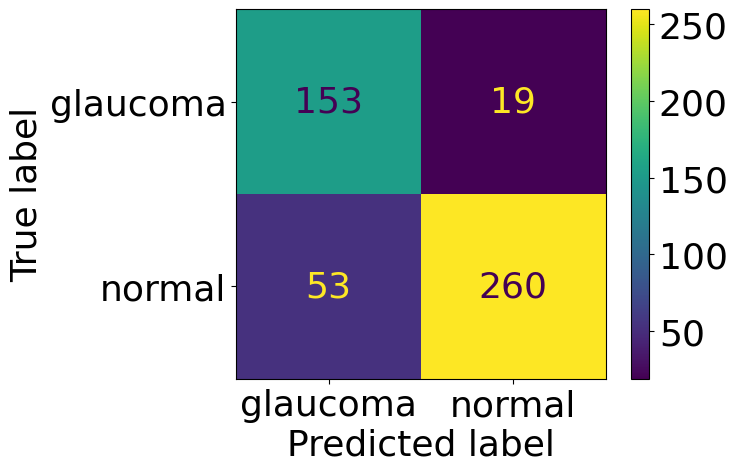

In [26]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels
                 )

In [27]:
plt.rcParams.update(plt.rcParamsDefault)

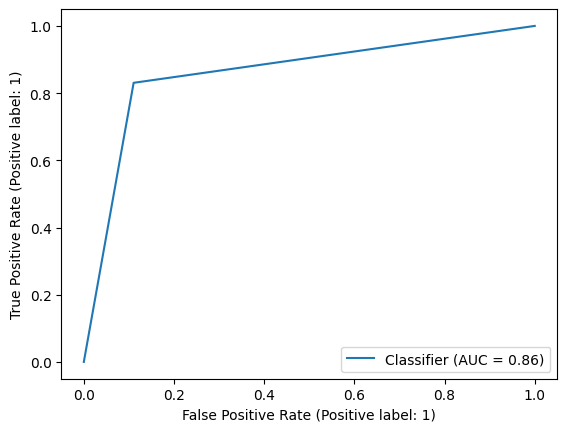

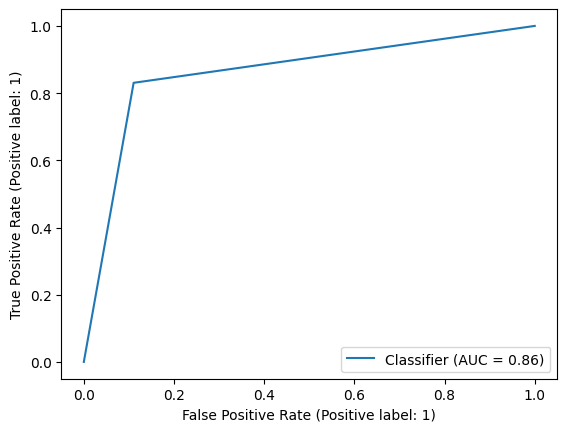

In [29]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'],
           pos_label=1)
plt.show()

### ResNet 50 -- ACRIMA

In [1]:
image_path = '/dataset/ACRIMA'
y_pred, filenames, classification, classification_label = resnet50.classify(image_path)
resnet50.write_results(y_pred, 'acrima', filenames, classification, classification_label)

In [7]:
df = resnet50.read_results('acrima')

In [8]:
df

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob
0,Im310_g_ACRIMA.jpg,Glaucoma,0.46714,0.53286,0,1,"(0.46714, 0.53286)"
1,Im311_g_ACRIMA.jpg,Glaucoma,0.95642,0.04358,0,0,"(0.95642, 0.04358)"
2,Im312_g_ACRIMA.jpg,Glaucoma,0.99976,0.00024,0,0,"(0.99976, 0.00024)"
3,Im313_g_ACRIMA.jpg,Glaucoma,0.99991,0.00009,0,0,"(0.99991, 9e-05)"
4,Im314_g_ACRIMA.jpg,Glaucoma,0.99996,0.00004,0,0,"(0.99996, 4e-05)"
...,...,...,...,...,...,...,...
700,Im305_ACRIMA.jpg,Healthy,0.00000,1.00000,1,1,"(0.0, 1.0)"
701,Im306_ACRIMA.jpg,Healthy,0.00025,0.99975,1,1,"(0.00025, 0.99975)"
702,Im307_ACRIMA.jpg,Healthy,0.00021,0.99979,1,1,"(0.00021, 0.99979)"
703,Im308_ACRIMA.jpg,Healthy,0.06100,0.93900,1,1,"(0.061, 0.939)"


In [8]:
labels = list(df.columns[2:4])

In [9]:
labels

['Glaucoma', 'Healthy']

In [7]:
plt.rcParams.update({'font.size': 26})

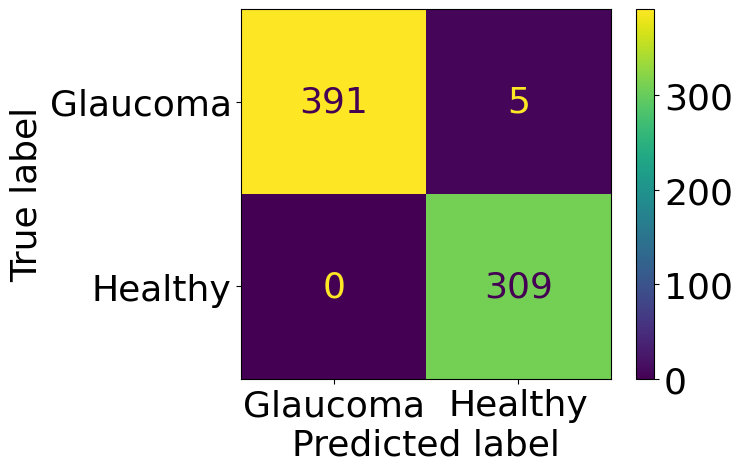

In [17]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels
                 )

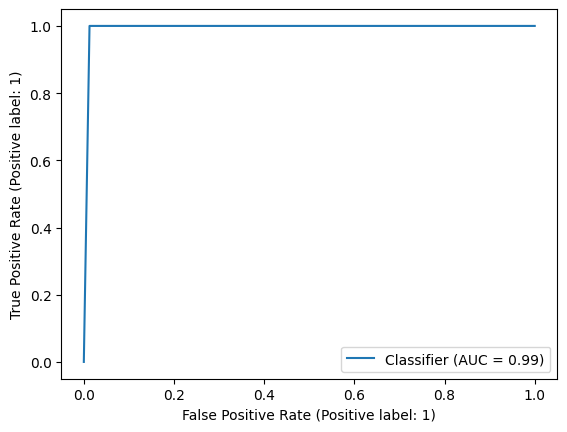

In [13]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'],
           pos_label=1)

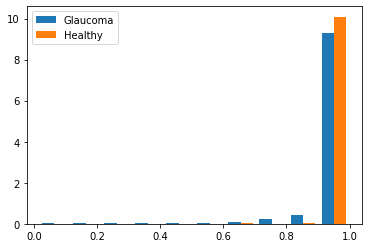

In [120]:
class_0, class_1 = Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

In [38]:
ex = Verify.n_examples(df, 0, False)

In [39]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
197,Im507_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000
6,Im316_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000
280,Im590_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000
64,Im374_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000
34,Im344_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000
293,Im603_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000
225,Im535_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000
213,Im523_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000
322,Im632_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000
24,Im334_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)",1.00000,0.00000


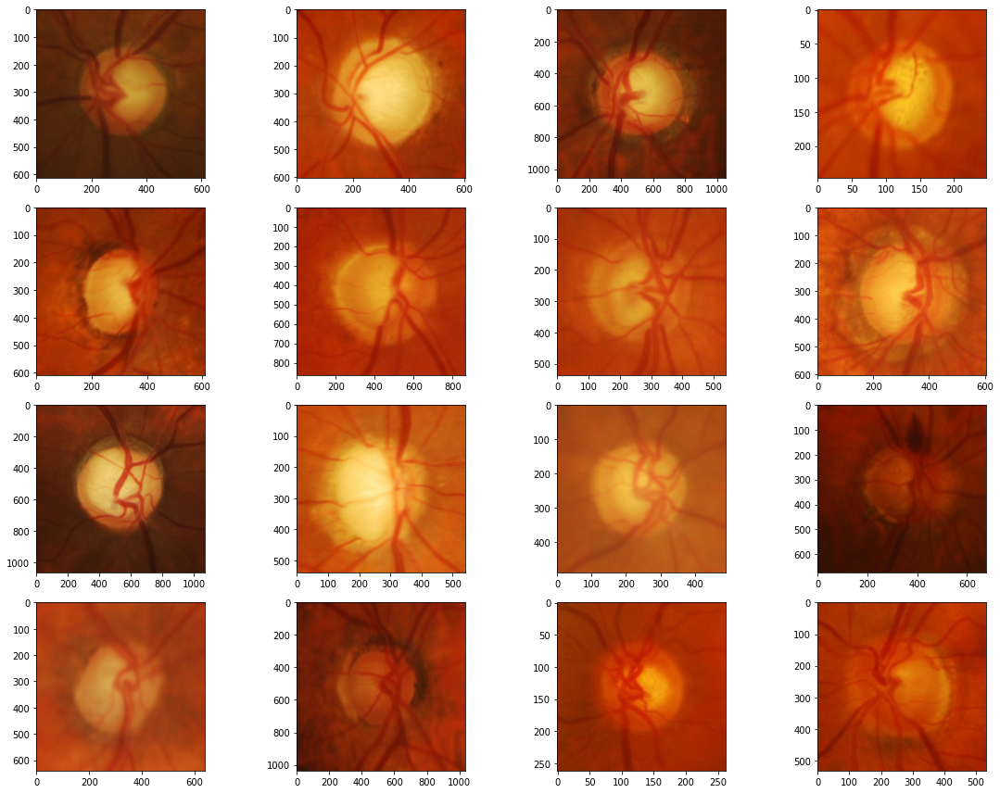

In [42]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [59]:
resnet50.write_examples(im_paths,0,0)

In [374]:
x = Verify.paths_to_dataset(im_paths)
resnet50.model.predict(x)

1/1 [==============================] - 0s 219ms/step


array([[0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ]], dtype=float32)

In [47]:
ex = Verify.n_examples(df, 0, True, 5)

In [48]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
112,Im422_g_ACRIMA.jpg,Glaucoma,0.01529,0.98471,0,1,"(0.01529, 0.98471)",0.01529,0.98471
57,Im367_g_ACRIMA.jpg,Glaucoma,0.20139,0.79861,0,1,"(0.20139, 0.79861)",0.20139,0.79861
247,Im557_g_ACRIMA.jpg,Glaucoma,0.29810,0.70190,0,1,"(0.2981, 0.7019)",0.29810,0.70190
288,Im598_g_ACRIMA.jpg,Glaucoma,0.37436,0.62564,0,1,"(0.37436, 0.62564)",0.37436,0.62564
0,Im310_g_ACRIMA.jpg,Glaucoma,0.46714,0.53286,0,1,"(0.46714, 0.53286)",0.46714,0.53286


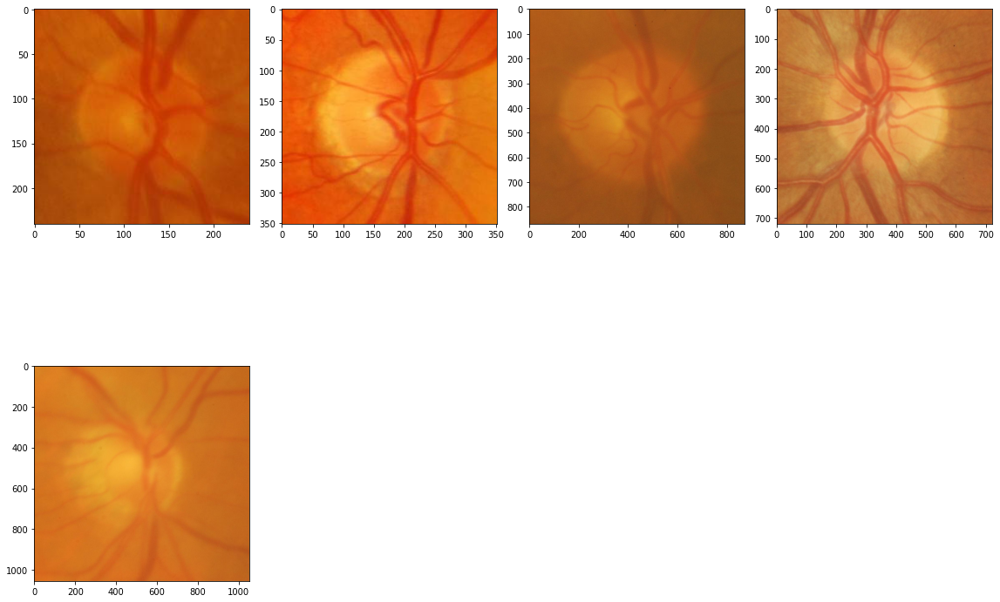

In [49]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [50]:
resnet50.write_examples(im_paths,0,1)

In [121]:
ex = Verify.n_examples(df, 1, False)

In [122]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
476,Im081_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
472,Im077_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
672,Im277_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
636,Im241_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
553,Im158_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
668,Im273_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
414,Im019_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
665,Im270_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
664,Im269_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
521,Im126_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0


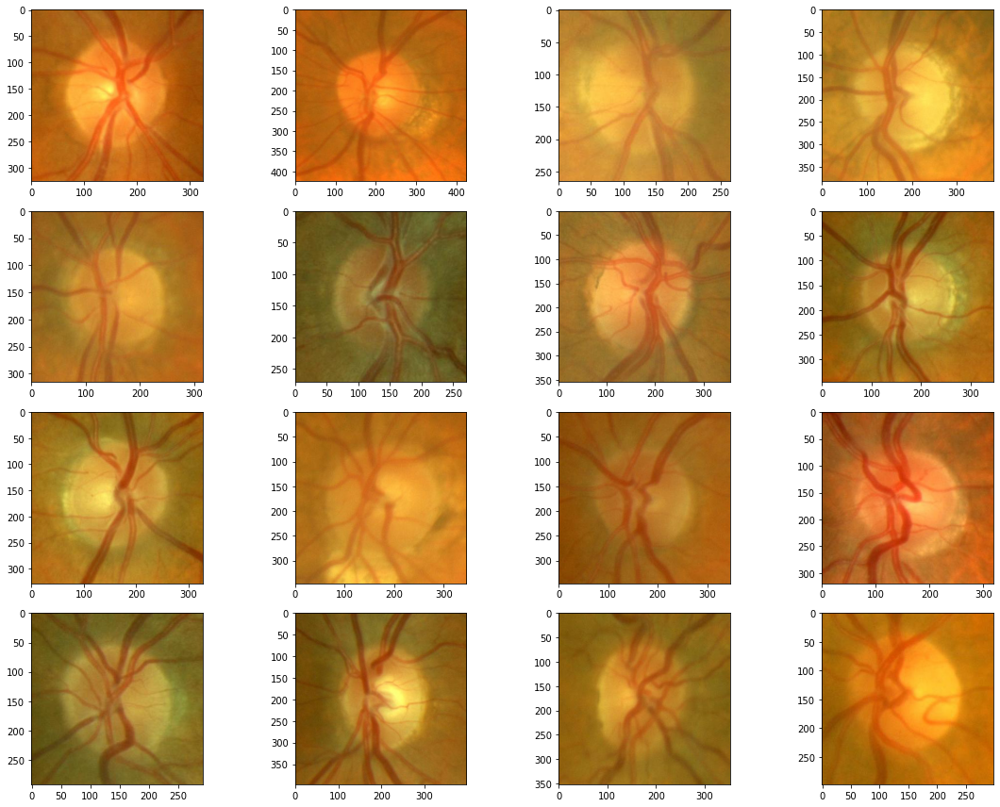

In [123]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [67]:
resnet50.write_examples(im_paths,1,1)

In [379]:
Verify.report(_y_pred=df['y_pred'],
              _y_true=df['y_true'])

              precision    recall  f1-score   support

           0       1.00      0.99      0.99       396
           1       0.98      1.00      0.99       309

    accuracy                           0.99       705
   macro avg       0.99      0.99      0.99       705
weighted avg       0.99      0.99      0.99       705



### ResNet 50 -- ORIGA

In [380]:
image_path = '/dataset/ORIGA/NotCropped'
y_pred, filenames, classification, classification_label = resnet50.classify(image_path)
resnet50.write_results(y_pred, 'origa', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 52s 631ms/step
650
[[0.6942113  0.30578867]
 [0.19450103 0.80549896]
 [0.0651299  0.9348701 ]
 ...
 [0.02499695 0.975003  ]
 [0.06917679 0.93082315]
 [0.05230055 0.9476994 ]]
Writing Predictions to CSV...
Done.


In [381]:
df = resnet50.read_results('origa')

In [382]:
labels = list(df.columns[2:4])

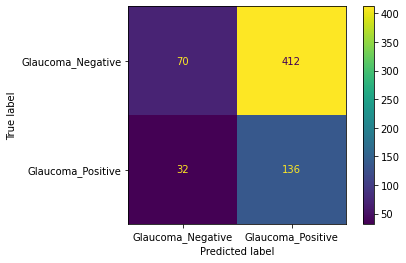

In [385]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'], display_labels=labels)

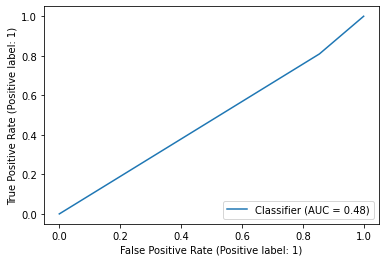

In [386]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

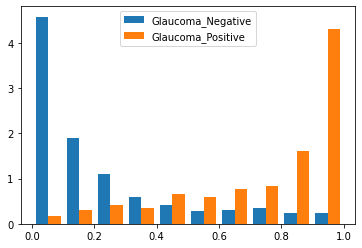

In [387]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

In [388]:
Verify.report(_y_pred=df['y_pred'],
              _y_true=df['y_true'])

              precision    recall  f1-score   support

           0       0.69      0.15      0.24       482
           1       0.25      0.81      0.38       168

    accuracy                           0.32       650
   macro avg       0.47      0.48      0.31       650
weighted avg       0.57      0.32      0.28       650



## ResNet 50 - ORIGA - cropped

In [389]:
image_path = '/dataset/ORIGA/Cropped'
y_pred, filenames, classification, classification_label = resnet50.classify(image_path)
resnet50.write_results(y_pred, 'origa_cropped', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 9s 103ms/step
650
[[0.7470559  0.2529442 ]
 [0.59841293 0.40158698]
 [0.96403444 0.03596562]
 ...
 [0.8555729  0.14442717]
 [0.88522464 0.11477534]
 [0.09109791 0.90890205]]
Writing Predictions to CSV...
Done.


In [390]:
df = resnet50.read_results('origa_cropped')

In [391]:
labels = list(df.columns[2:4])

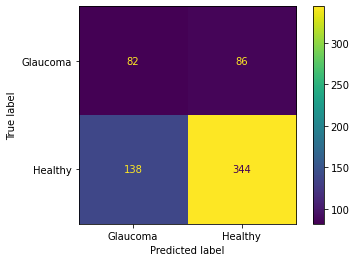

In [392]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

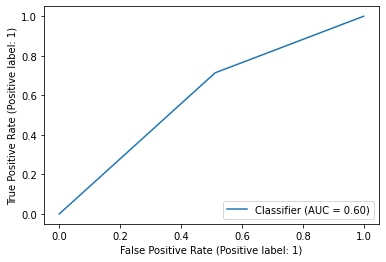

In [393]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

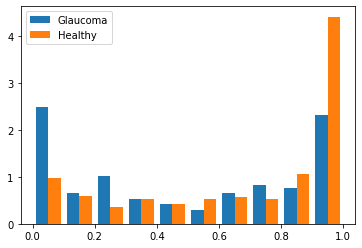

In [395]:
class_0, class_1 = Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)

In [81]:
Verify.report(_y_pred=df['y_pred'],
              _y_true=df['y_true'])

              precision    recall  f1-score   support

           0       0.37      0.49      0.42       168
           1       0.80      0.71      0.75       482

    accuracy                           0.66       650
   macro avg       0.59      0.60      0.59       650
weighted avg       0.69      0.66      0.67       650



## ResNet 50 - ORIGA - cropped larger

In [396]:
image_path = '/dataset/ORIGA/CroppedLarger'
y_pred, filenames, classification, classification_label = resnet50.classify(image_path)
resnet50.write_results(y_pred, 'origa_cropped_larger', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 9s 102ms/step
650
[[5.9172583e-01 4.0827423e-01]
 [9.7833234e-01 2.1667609e-02]
 [4.9979764e-01 5.0020242e-01]
 ...
 [9.5427579e-01 4.5724176e-02]
 [9.9906737e-01 9.3263242e-04]
 [8.1830667e-03 9.9181694e-01]]
Writing Predictions to CSV...
Done.


In [397]:
df = resnet50.read_results('origa_cropped_larger')

In [398]:
labels = list(df.columns[2:4])

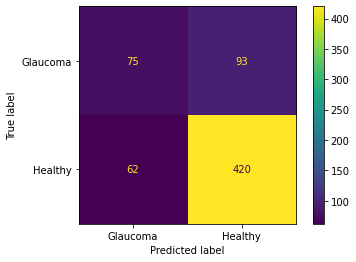

In [399]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels = labels)

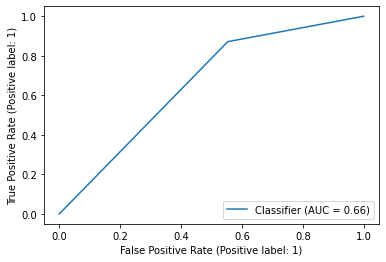

In [400]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

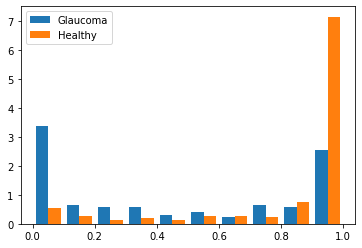

In [402]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

In [403]:
Verify.report(_y_pred=df['y_pred'],
              _y_true=df['y_true'])

              precision    recall  f1-score   support

           0       0.55      0.45      0.49       168
           1       0.82      0.87      0.84       482

    accuracy                           0.76       650
   macro avg       0.68      0.66      0.67       650
weighted avg       0.75      0.76      0.75       650



## ResNet 50 - ORIGA - cropped Diaz

In [404]:
image_path = '/dataset/ORIGA/CroppedDiaz'
y_pred, filenames, classification, classification_label = resnet50.classify(image_path)
resnet50.write_results(y_pred, 'origa_diaz', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 9s 111ms/step
650
[[6.2525421e-01 3.7474576e-01]
 [9.7597754e-01 2.4022568e-02]
 [2.3908316e-01 7.6091689e-01]
 ...
 [9.3949062e-01 6.0509268e-02]
 [9.9975556e-01 2.4439633e-04]
 [3.2828309e-02 9.6717167e-01]]
Writing Predictions to CSV...
Done.


In [405]:
df = resnet50.read_results('origa_diaz')

In [406]:
labels = list(df.columns[2:4])

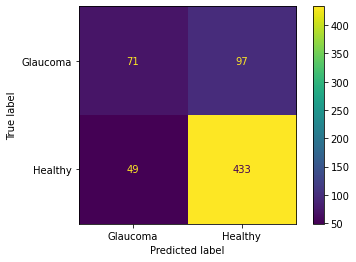

In [407]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels = labels)

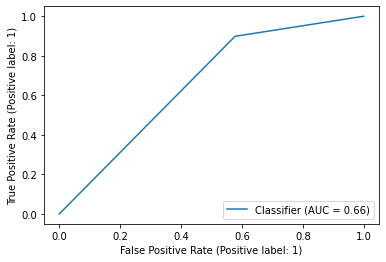

In [408]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

Images cropped by DIAZ method achieved similar AUC to mine largest crop

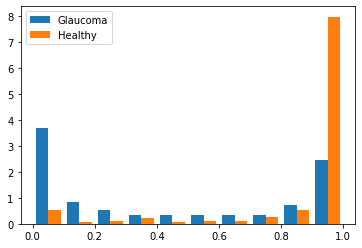

In [409]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

In [410]:
Verify.report(_y_pred=df['y_pred'],
              _y_true=df['y_true'])

              precision    recall  f1-score   support

           0       0.59      0.42      0.49       168
           1       0.82      0.90      0.86       482

    accuracy                           0.78       650
   macro avg       0.70      0.66      0.67       650
weighted avg       0.76      0.78      0.76       650



# Inception V3

## Inception V3 - RIM ONE DL

In [30]:
image_path = 'D:/MasterThesis/Datasets/RIM-ONE_DL_images/RIM-ONE_DL_images/partitioned_randomly/all_data'

In [31]:
y_pred, filenames, classification, classification_label = inception_v3.classify(image_path)
inception_v3.write_results(y_pred, 'rimone', filenames, classification, classification_label)

Found 485 images belonging to 2 classes.
61/61 [==============================] - 130s 2s/step
485
[[9.94980395e-01 5.01959678e-03]
 [7.82352507e-01 2.17647523e-01]
 [2.80445121e-04 9.99719560e-01]
 [3.07779340e-03 9.96922195e-01]
 [2.79241614e-03 9.97207582e-01]
 [1.44657254e-01 8.55342746e-01]
 [7.99465179e-01 2.00534821e-01]
 [2.90809385e-03 9.97091889e-01]
 [4.26151484e-01 5.73848486e-01]
 [2.84129232e-01 7.15870738e-01]
 [8.45892500e-05 9.99915361e-01]
 [3.03642064e-01 6.96357906e-01]
 [9.99972105e-01 2.78994557e-05]
 [9.99986887e-01 1.31464640e-05]
 [9.78236735e-01 2.17632037e-02]
 [9.99726713e-01 2.73330515e-04]
 [9.99745190e-01 2.54843821e-04]
 [9.98765826e-01 1.23421522e-03]
 [9.83404219e-01 1.65957771e-02]
 [9.81138527e-01 1.88614745e-02]
 [9.97936845e-01 2.06323736e-03]
 [9.99964714e-01 3.52866628e-05]
 [9.99672413e-01 3.27588059e-04]
 [1.90925479e-04 9.99809086e-01]
 [3.96118373e-01 6.03881657e-01]
 [4.78912983e-03 9.95210946e-01]
 [9.97864664e-01 2.13537575e-03]
 [9.986227

In [32]:
df = inception_v3.read_results('rimone')

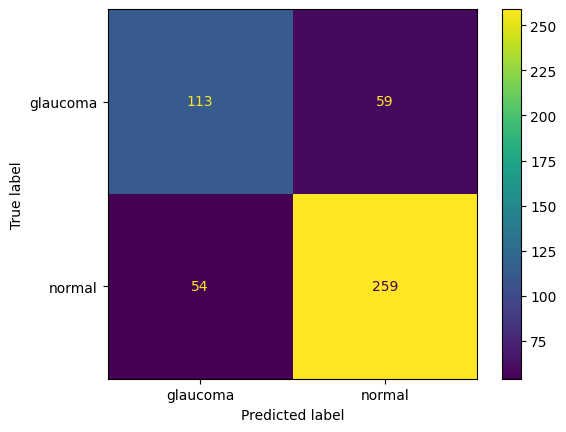

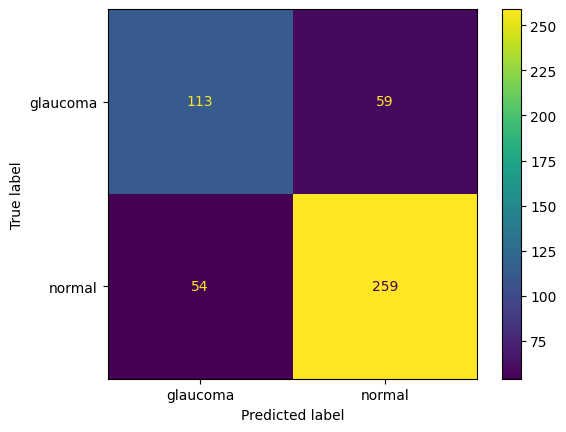

In [34]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)
plt.show()

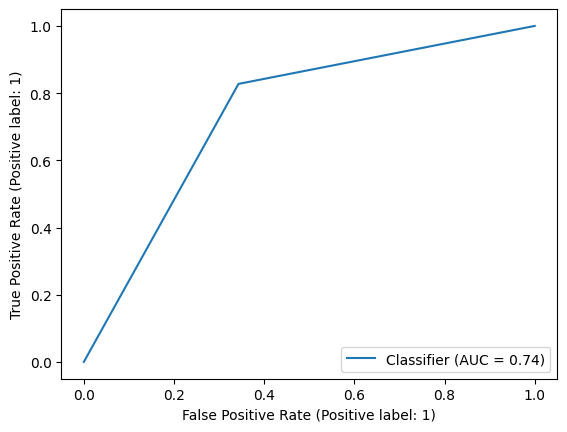

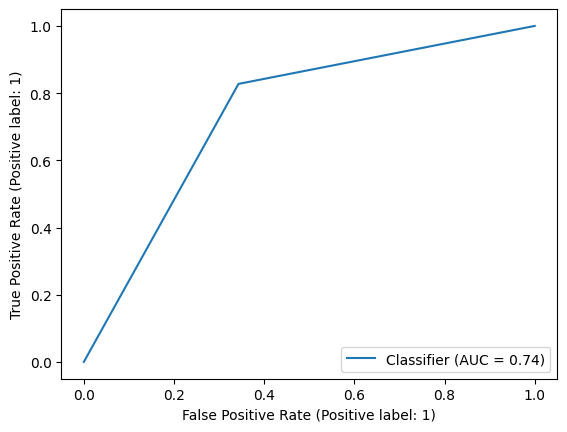

In [36]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])
plt.show()


## Inception V3 -- ACRIMA

In [13]:
image_path = '/dataset/ACRIMA'
# y_pred, filenames, classification, classification_label = inception_v3.classify(image_path)
# inception_v3.write_results(y_pred, 'acrima', filenames, classification, classification_label)

In [18]:
df = inception_v3.read_results('acrima')

In [19]:
labels = list(df.columns[2:4])

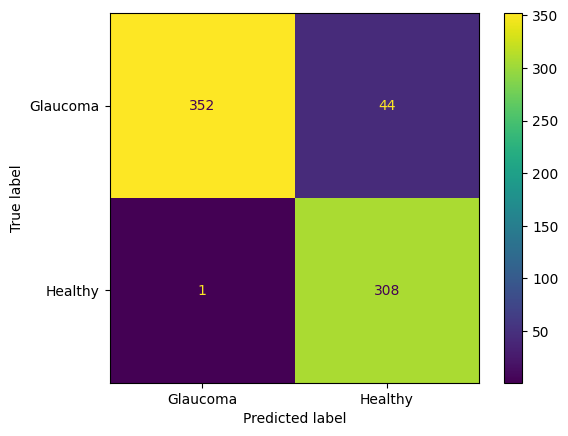

In [15]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

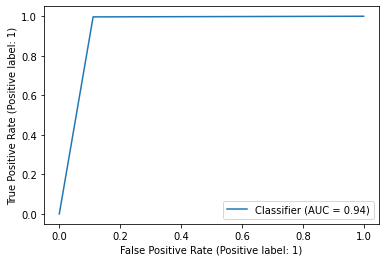

In [415]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

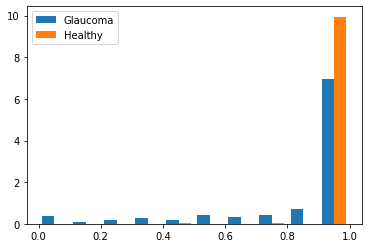

In [416]:
class_0, class_1 = Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)

In [434]:
ex = Verify.examples(df, class_0, 0, False, 0.0001)

In [436]:
ex

40     Im350_g_ACRIMA.jpg
124    Im434_g_ACRIMA.jpg
225    Im535_g_ACRIMA.jpg
226    Im536_g_ACRIMA.jpg
231    Im541_g_ACRIMA.jpg
339    Im649_g_ACRIMA.jpg
346    Im656_g_ACRIMA.jpg
Name: image_name, dtype: object

In [32]:
ex = Verify.n_examples(df, 0, False)

In [33]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
339,Im649_g_ACRIMA.jpg,Glaucoma,0.99999,0.00001,0,0,"(0.99999, 1e-05)",0.99999,0.00001
40,Im350_g_ACRIMA.jpg,Glaucoma,0.99998,0.00002,0,0,"(0.99998, 2e-05)",0.99998,0.00002
226,Im536_g_ACRIMA.jpg,Glaucoma,0.99998,0.00002,0,0,"(0.99998, 2e-05)",0.99998,0.00002
124,Im434_g_ACRIMA.jpg,Glaucoma,0.99998,0.00002,0,0,"(0.99998, 2e-05)",0.99998,0.00002
225,Im535_g_ACRIMA.jpg,Glaucoma,0.99997,0.00003,0,0,"(0.99997, 3e-05)",0.99997,0.00003
231,Im541_g_ACRIMA.jpg,Glaucoma,0.99994,0.00006,0,0,"(0.99994, 6e-05)",0.99994,0.00006
346,Im656_g_ACRIMA.jpg,Glaucoma,0.99993,0.00007,0,0,"(0.99993, 7e-05)",0.99993,0.00007
369,Im679_g_ACRIMA.jpg,Glaucoma,0.99989,0.00011,0,0,"(0.99989, 0.00011)",0.99989,0.00011
169,Im479_g_ACRIMA.jpg,Glaucoma,0.99988,0.00012,0,0,"(0.99988, 0.00012)",0.99988,0.00012
356,Im666_g_ACRIMA.jpg,Glaucoma,0.99988,0.00012,0,0,"(0.99988, 0.00012)",0.99988,0.00012


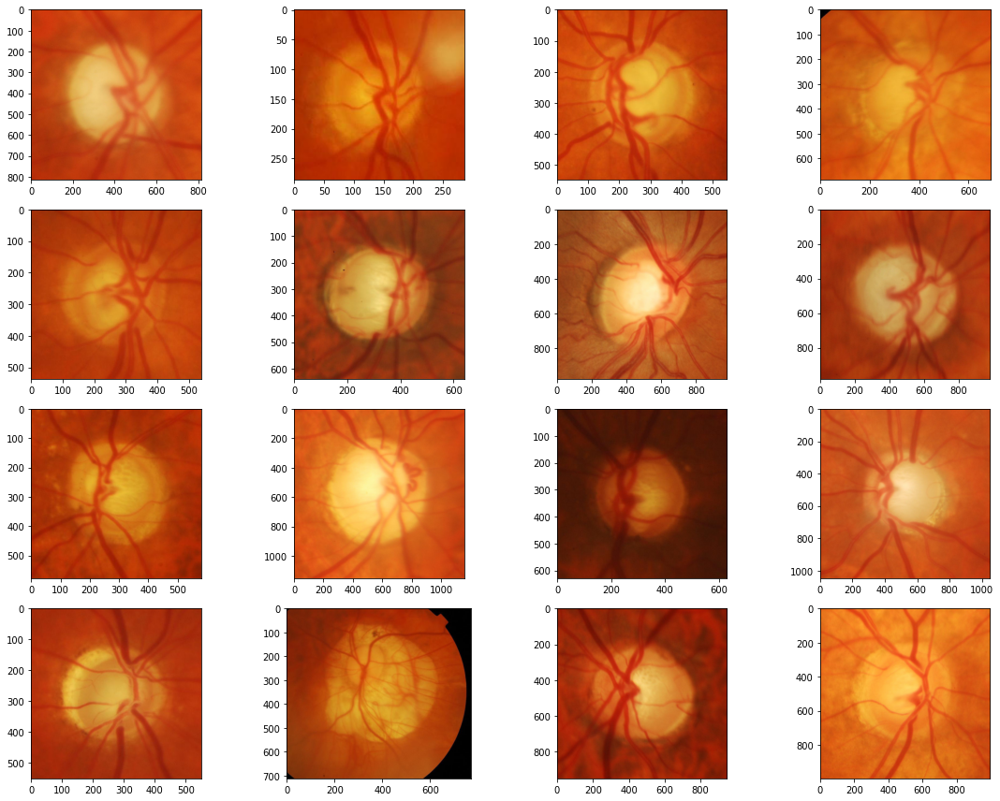

In [34]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [35]:
inception_v3.write_examples(im_paths,0,0)

In [27]:
ex = Verify.n_examples(df, 0, True)

In [28]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
247,Im557_g_ACRIMA.jpg,Glaucoma,0.00129,0.99871,0,1,"(0.00129, 0.99871)",0.00129,0.99871
392,Im702_g_ACRIMA.JPG,Glaucoma,0.00147,0.99853,0,1,"(0.00147, 0.99853)",0.00147,0.99853
286,Im596_g_ACRIMA.jpg,Glaucoma,0.00977,0.99023,0,1,"(0.00977, 0.99023)",0.00977,0.99023
344,Im654_g_ACRIMA.jpg,Glaucoma,0.01227,0.98773,0,1,"(0.01227, 0.98773)",0.01227,0.98773
263,Im573_g_ACRIMA.jpg,Glaucoma,0.02872,0.97128,0,1,"(0.02872, 0.97128)",0.02872,0.97128
299,Im609_g_ACRIMA.jpg,Glaucoma,0.04182,0.95818,0,1,"(0.04182, 0.95818)",0.04182,0.95818
204,Im514_g_ACRIMA.jpg,Glaucoma,0.04756,0.95244,0,1,"(0.04756, 0.95244)",0.04756,0.95244
252,Im562_g_ACRIMA.jpg,Glaucoma,0.04848,0.95152,0,1,"(0.04848, 0.95152)",0.04848,0.95152
248,Im558_g_ACRIMA.jpg,Glaucoma,0.05528,0.94472,0,1,"(0.05528, 0.94472)",0.05528,0.94472
145,Im455_g_ACRIMA.jpg,Glaucoma,0.05733,0.94267,0,1,"(0.05733, 0.94267)",0.05733,0.94267


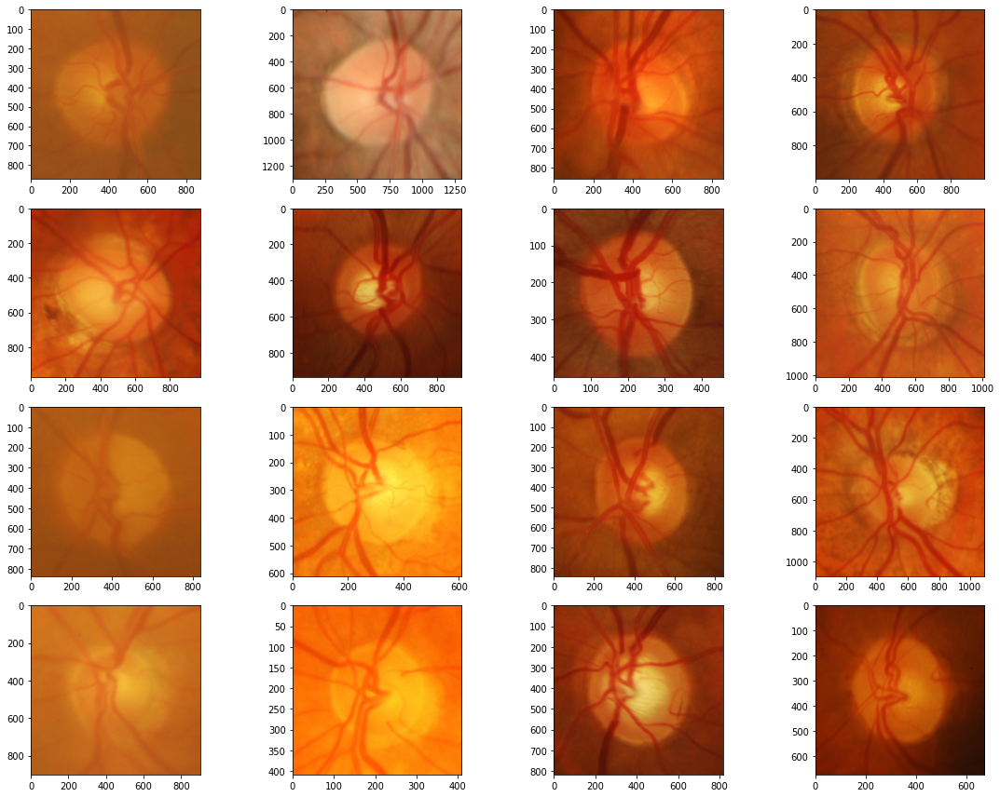

In [29]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [31]:
inception_v3.write_examples(im_paths,0,1)

In [36]:
ex = Verify.n_examples(df, 1, False)

In [37]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
549,Im154_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
491,Im096_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
512,Im117_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
606,Im211_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
607,Im212_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
511,Im116_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
510,Im115_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
610,Im215_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
509,Im114_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
612,Im217_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0


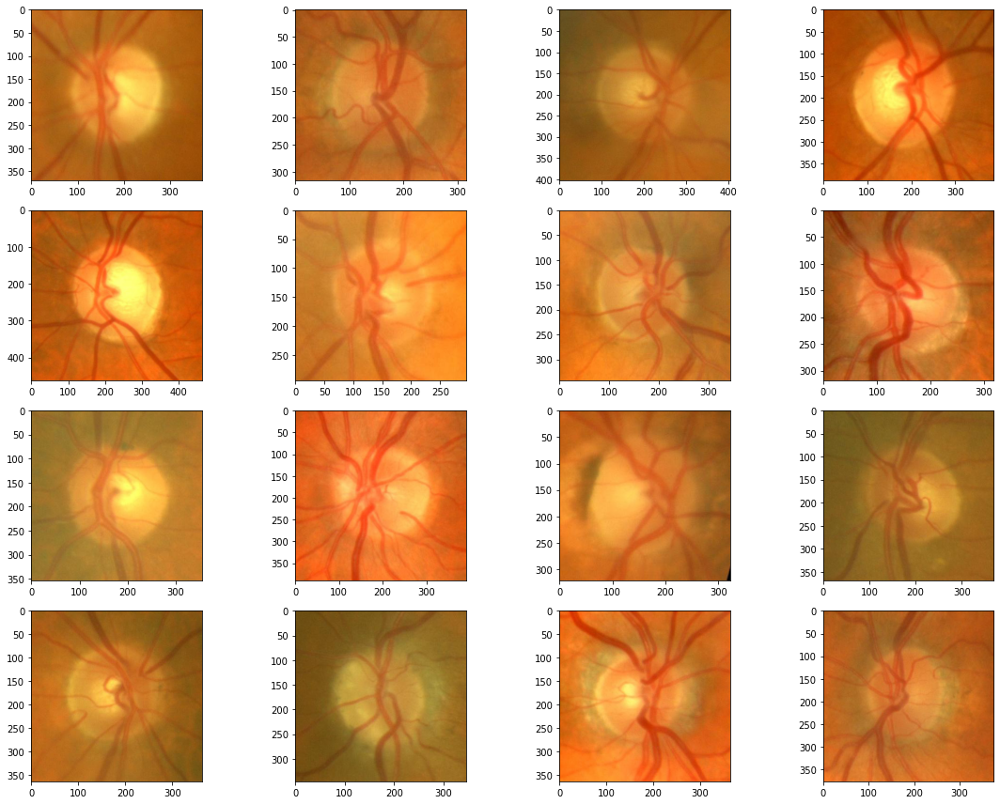

In [38]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [39]:
inception_v3.write_examples(im_paths,1,1)

In [42]:
ex = Verify.n_examples(df, 1, True, 1)

In [43]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
406,Im011_ACRIMA.jpg,Healthy,0.59762,0.40238,1,0,"(0.59762, 0.40238)",0.59762,0.40238


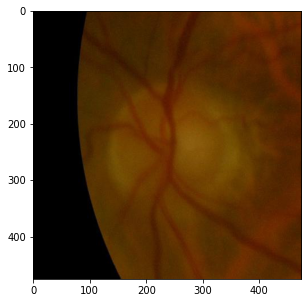

In [44]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [45]:
inception_v3.write_examples(im_paths,1,0)

As it can be seen InceptionV3 works worse than ResNet50

### Inception V3 -- ORIGA

In [441]:
image_path = '/dataset/ORIGA/NotCropped'
y_pred, filenames, classification, classification_label = inception_v3.classify(image_path)
inception_v3.write_results(y_pred, 'origa', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 53s 638ms/step
650
[[0.79340976 0.20659024]
 [0.83307326 0.16692674]
 [0.806279   0.1937209 ]
 ...
 [0.3433583  0.65664166]
 [0.9682262  0.03177379]
 [0.53927827 0.4607217 ]]
Writing Predictions to CSV...
Done.


In [442]:
df = inception_v3.read_results('origa')

In [443]:
labels = list(df.columns[2:4])

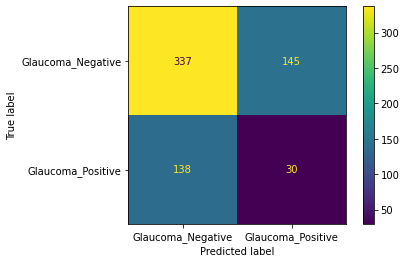

In [444]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

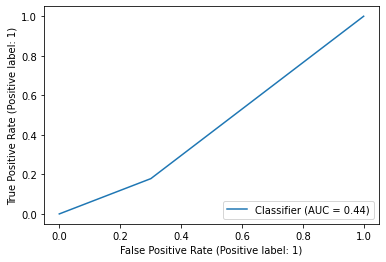

In [445]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

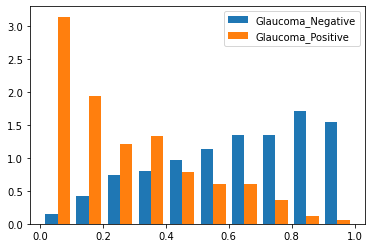

In [447]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## Inception V3 - ORIGA - cropped

In [448]:
image_path = '/dataset/ORIGA/Cropped'
y_pred, filenames, classification, classification_label = inception_v3.classify(image_path)
inception_v3.write_results(y_pred, 'origa_cropped', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 10s 123ms/step
650
[[0.2309093  0.76909065]
 [0.1219129  0.87808704]
 [0.90280825 0.09719179]
 ...
 [0.994032   0.00596803]
 [0.96887726 0.03112278]
 [0.15593821 0.84406173]]
Writing Predictions to CSV...
Done.


In [449]:
df = inception_v3.read_results('origa_cropped')

In [450]:
labels = list(df.columns[2:4])

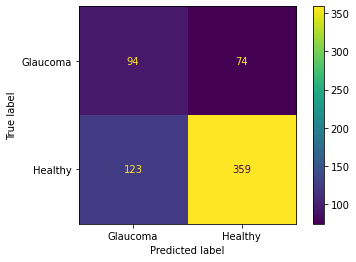

In [451]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

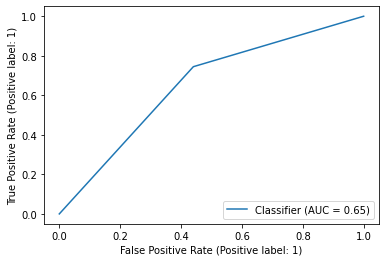

In [452]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

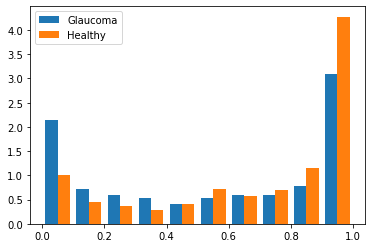

In [453]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## Inception V3 - ORIGA - cropped larger

In [454]:
image_path = '/dataset/ORIGA/CroppedLarger'
y_pred, filenames, classification, classification_label = inception_v3.classify(image_path)
inception_v3.write_results(y_pred, 'origa_cropped_larger', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 10s 124ms/step
650
[[3.7749368e-01 6.2250626e-01]
 [1.0199512e-01 8.9800483e-01]
 [9.6600831e-01 3.3991590e-02]
 ...
 [9.9868155e-01 1.3185130e-03]
 [9.9910152e-01 8.9850981e-04]
 [5.6144930e-02 9.4385505e-01]]
Writing Predictions to CSV...
Done.


In [455]:
df = inception_v3.read_results('origa_cropped_larger')

In [456]:
labels = list(df.columns[2:4])

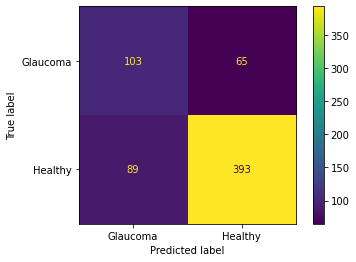

In [457]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

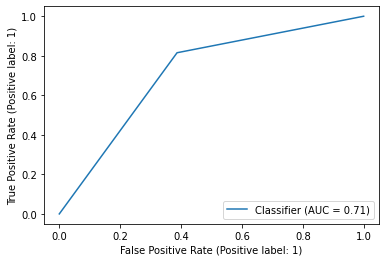

In [458]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

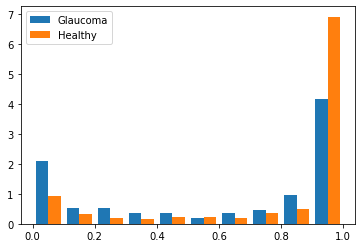

In [459]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## Inception V3 - ORIGA - cropped Diaz

In [460]:
image_path = '/dataset/ORIGA/CroppedDiaz'
y_pred, filenames, classification, classification_label = inception_v3.classify(image_path)
inception_v3.write_results(y_pred, 'origa_diaz', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 10s 124ms/step
650
[[7.5848740e-01 2.4151251e-01]
 [2.0225418e-01 7.9774588e-01]
 [9.8855883e-01 1.1441124e-02]
 ...
 [9.9944341e-01 5.5655069e-04]
 [9.9900669e-01 9.9334109e-04]
 [3.2307374e-01 6.7692626e-01]]
Writing Predictions to CSV...
Done.


In [461]:
df = inception_v3.read_results('origa_diaz')

In [462]:
labels = list(df.columns[2:4])

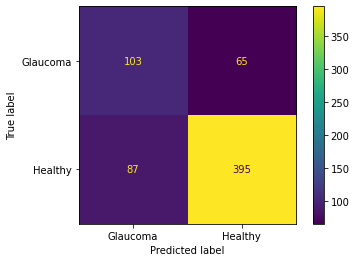

In [463]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

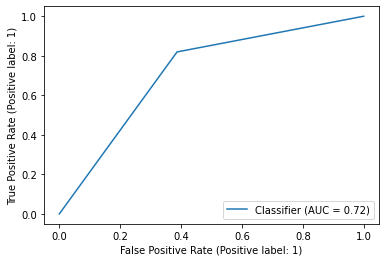

In [464]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

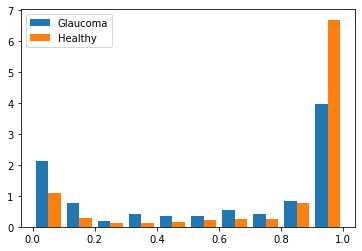

In [465]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

# Xception

## Xception - RIM ONE DL

In [37]:
image_path = 'D:/MasterThesis/Datasets/RIM-ONE_DL_images/RIM-ONE_DL_images/partitioned_randomly/all_data'

In [39]:
y_pred, filenames, classification, classification_label = xception.classify(image_path)
xception.write_results(y_pred, 'rimone', filenames, classification, classification_label)

Found 485 images belonging to 2 classes.
61/61 [==============================] - 195s 3s/step
485
[[0.27779222 0.7222078 ]
 [0.9406011  0.05939889]
 [0.13017024 0.8698298 ]
 [0.34628913 0.6537108 ]
 [0.14606667 0.85393333]
 [0.5645931  0.43540683]
 [0.93982184 0.06017823]
 [0.06053334 0.9394667 ]
 [0.98507565 0.0149243 ]
 [0.6347246  0.36527535]
 [0.19196731 0.80803263]
 [0.58341753 0.41658247]
 [0.8808723  0.11912766]
 [0.94431883 0.05568122]
 [0.88810086 0.11189919]
 [0.84625715 0.15374279]
 [0.988224   0.01177592]
 [0.44766805 0.552332  ]
 [0.8529644  0.14703557]
 [0.7486424  0.2513577 ]
 [0.86492854 0.13507141]
 [0.9463203  0.05367969]
 [0.29562855 0.7043715 ]
 [0.0776604  0.9223396 ]
 [0.06656216 0.9334378 ]
 [0.08302706 0.91697294]
 [0.5456713  0.45432872]
 [0.92743945 0.07256062]
 [0.95934975 0.04065026]
 [0.8744071  0.12559286]
 [0.9688324  0.03116758]
 [0.499345   0.50065494]
 [0.94699365 0.0530064 ]
 [0.7662929  0.23370706]
 [0.75635946 0.24364054]
 [0.7027334  0.29726663]
 

In [40]:
df = xception.read_results('rimone')

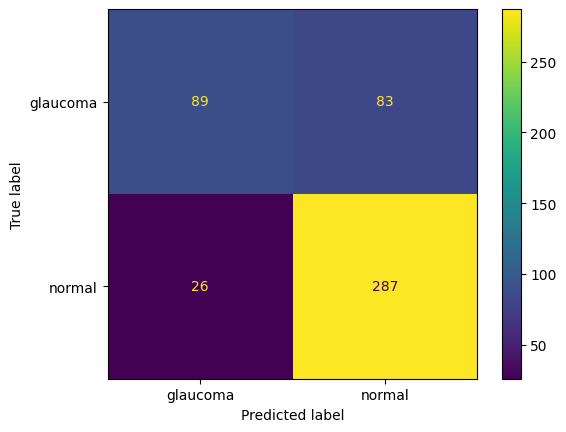

In [41]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)
plt.show()

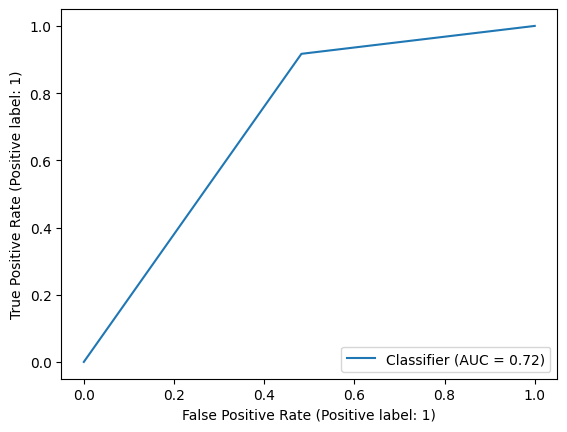

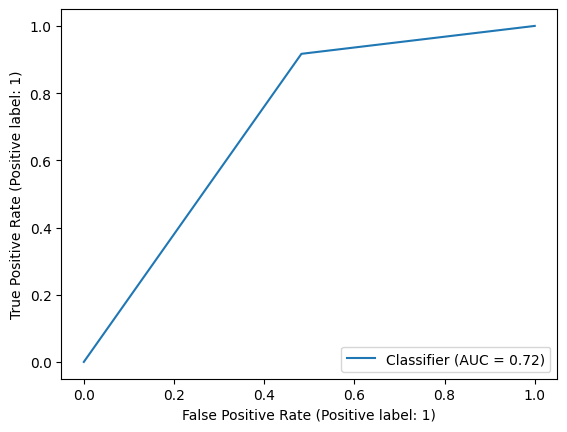

In [43]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])
plt.show()

## Xception -- ACRIMA

In [466]:
image_path = '/dataset/ACRIMA'
y_pred, filenames, classification, classification_label = xception.classify(image_path)
xception.write_results(y_pred, 'acrima', filenames, classification, classification_label)

Found 705 images belonging to 2 classes.
89/89 [==============================] - 21s 221ms/step
705
[[0.54348266 0.4565174 ]
 [0.6558169  0.34418312]
 [0.7789972  0.22100274]
 ...
 [0.00759789 0.9924021 ]
 [0.01679457 0.9832054 ]
 [0.00910189 0.9908981 ]]
Writing Predictions to CSV...
Done.


In [8]:
df = xception.read_results('acrima')

In [9]:
labels = list(df.columns[2:4])

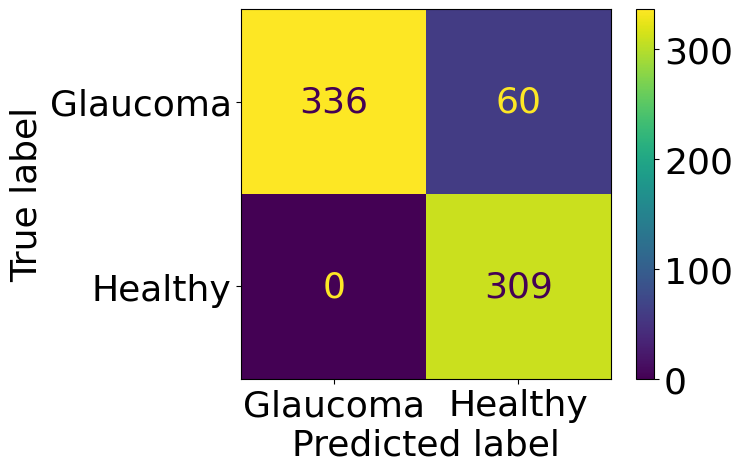

In [10]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

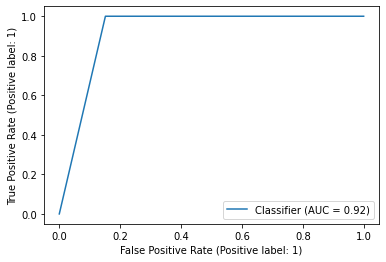

In [530]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

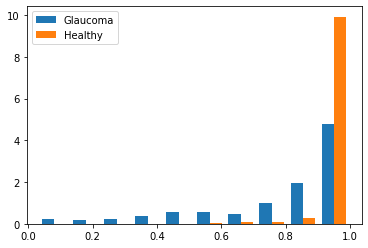

In [531]:
class_0, class_1 = Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

In [54]:
ex = Verify.n_examples(df, 0, False)

In [55]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
85,Im395_g_ACRIMA.jpg,Glaucoma,0.99814,0.00186,0,0,"(0.99814, 0.00186)",0.99814,0.00186
6,Im316_g_ACRIMA.jpg,Glaucoma,0.99783,0.00217,0,0,"(0.99783, 0.00217)",0.99783,0.00217
3,Im313_g_ACRIMA.jpg,Glaucoma,0.99696,0.00304,0,0,"(0.99696, 0.00304)",0.99696,0.00304
270,Im580_g_ACRIMA.jpg,Glaucoma,0.99666,0.00334,0,0,"(0.99666, 0.00334)",0.99666,0.00334
234,Im544_g_ACRIMA.jpg,Glaucoma,0.99585,0.00415,0,0,"(0.99585, 0.00415)",0.99585,0.00415
280,Im590_g_ACRIMA.jpg,Glaucoma,0.99583,0.00417,0,0,"(0.99583, 0.00417)",0.99583,0.00417
138,Im448_g_ACRIMA.jpg,Glaucoma,0.99578,0.00422,0,0,"(0.99578, 0.00422)",0.99578,0.00422
226,Im536_g_ACRIMA.jpg,Glaucoma,0.99549,0.00451,0,0,"(0.99549, 0.00451)",0.99549,0.00451
195,Im505_g_ACRIMA.jpg,Glaucoma,0.99523,0.00477,0,0,"(0.99523, 0.00477)",0.99523,0.00477
370,Im680_g_ACRIMA.jpg,Glaucoma,0.99513,0.00487,0,0,"(0.99513, 0.00487)",0.99513,0.00487


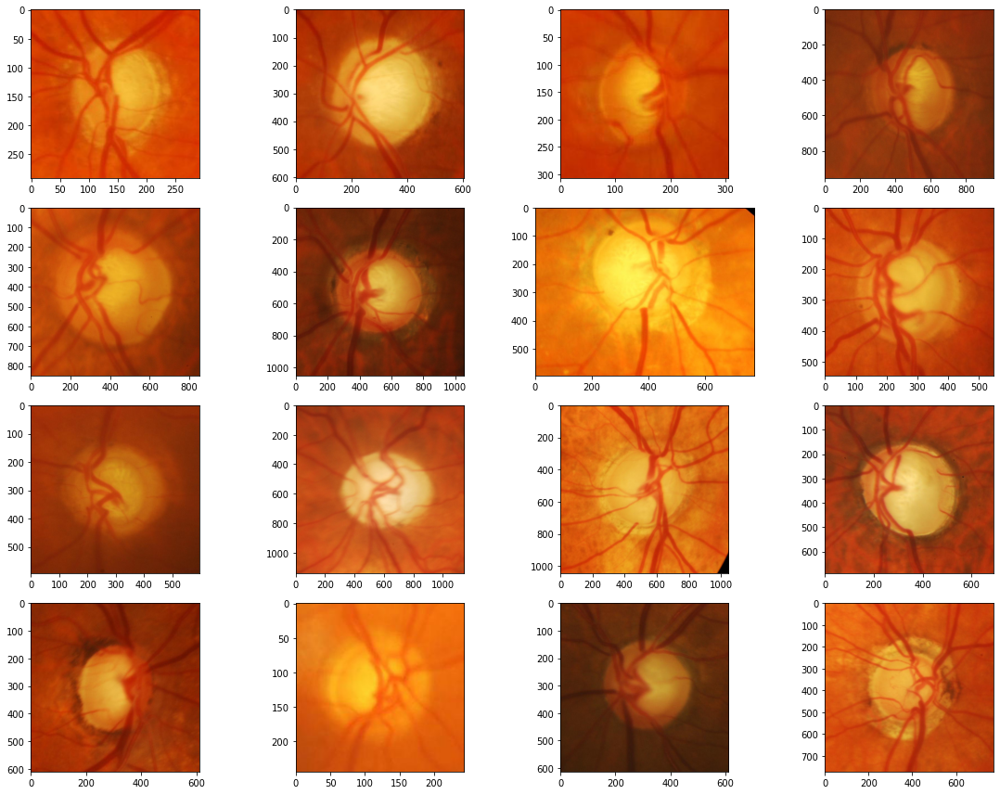

In [56]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [57]:
xception.write_examples(im_paths, 0, 0)

In [58]:
ex = Verify.n_examples(df, 0, True)

In [59]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
247,Im557_g_ACRIMA.jpg,Glaucoma,0.03269,0.96731,0,1,"(0.03269, 0.96731)",0.03269,0.96731
18,Im328_g_ACRIMA.jpg,Glaucoma,0.04359,0.95641,0,1,"(0.04359, 0.95641)",0.04359,0.95641
201,Im511_g_ACRIMA.jpg,Glaucoma,0.06520,0.93480,0,1,"(0.0652, 0.9348)",0.06520,0.93480
298,Im608_g_ACRIMA.jpg,Glaucoma,0.07096,0.92904,0,1,"(0.07096, 0.92904)",0.07096,0.92904
318,Im628_g_ACRIMA.jpg,Glaucoma,0.07098,0.92902,0,1,"(0.07098, 0.92902)",0.07098,0.92902
310,Im620_g_ACRIMA.jpg,Glaucoma,0.08802,0.91198,0,1,"(0.08802, 0.91198)",0.08802,0.91198
204,Im514_g_ACRIMA.jpg,Glaucoma,0.09748,0.90252,0,1,"(0.09748, 0.90252)",0.09748,0.90252
287,Im597_g_ACRIMA.jpg,Glaucoma,0.11491,0.88509,0,1,"(0.11491, 0.88509)",0.11491,0.88509
56,Im366_g_ACRIMA.jpg,Glaucoma,0.11966,0.88034,0,1,"(0.11966, 0.88034)",0.11966,0.88034
278,Im588_g_ACRIMA.jpg,Glaucoma,0.13275,0.86725,0,1,"(0.13275, 0.86725)",0.13275,0.86725


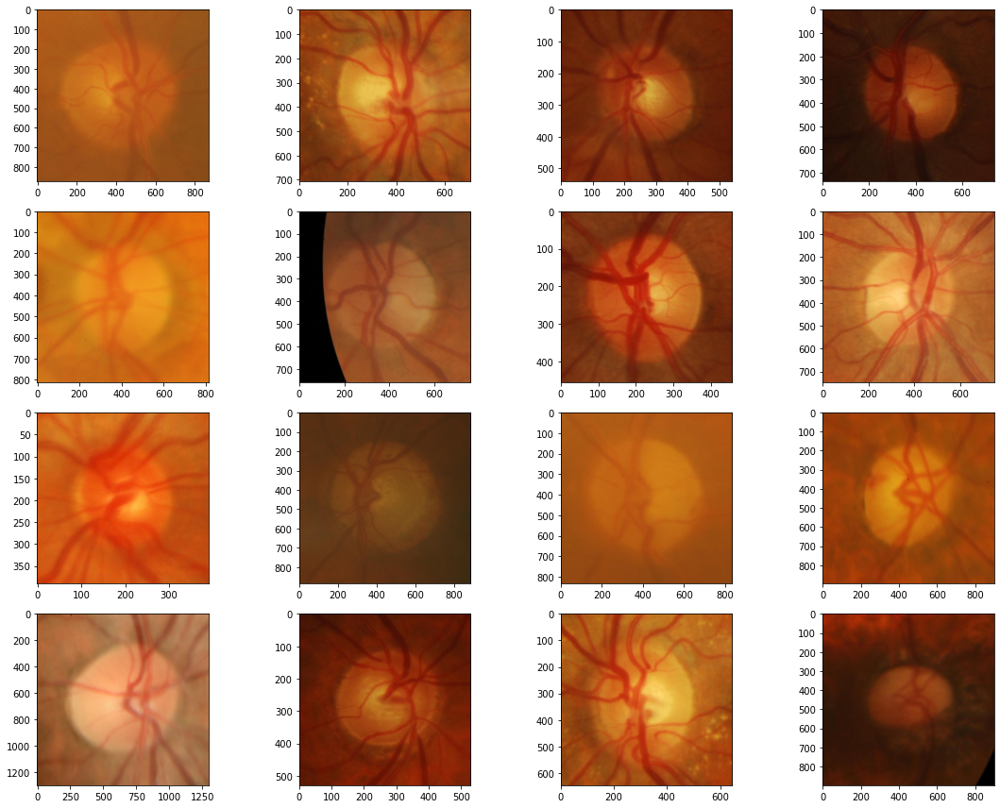

In [60]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [61]:
xception.write_examples(im_paths,0,1)

In [62]:
ex = Verify.n_examples(df, 1, False)

In [63]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
456,Im061_ACRIMA.jpg,Healthy,0.00159,0.99841,1,1,"(0.00159, 0.99841)",0.00159,0.99841
565,Im170_ACRIMA.jpg,Healthy,0.00238,0.99762,1,1,"(0.00238, 0.99762)",0.00238,0.99762
516,Im121_ACRIMA.jpg,Healthy,0.00255,0.99746,1,1,"(0.00255, 0.99746)",0.00255,0.99746
697,Im302_ACRIMA.jpg,Healthy,0.00291,0.99709,1,1,"(0.00291, 0.99709)",0.00291,0.99709
689,Im294_ACRIMA.jpg,Healthy,0.00294,0.99706,1,1,"(0.00294, 0.99706)",0.00294,0.99706
572,Im177_ACRIMA.jpg,Healthy,0.00306,0.99694,1,1,"(0.00306, 0.99694)",0.00306,0.99694
453,Im058_ACRIMA.jpg,Healthy,0.00309,0.99691,1,1,"(0.00309, 0.99691)",0.00309,0.99691
548,Im153_ACRIMA.jpg,Healthy,0.00355,0.99645,1,1,"(0.00355, 0.99645)",0.00355,0.99645
396,Im001_ACRIMA.jpg,Healthy,0.00359,0.99641,1,1,"(0.00359, 0.99641)",0.00359,0.99641
691,Im296_ACRIMA.jpg,Healthy,0.00359,0.99641,1,1,"(0.00359, 0.99641)",0.00359,0.99641


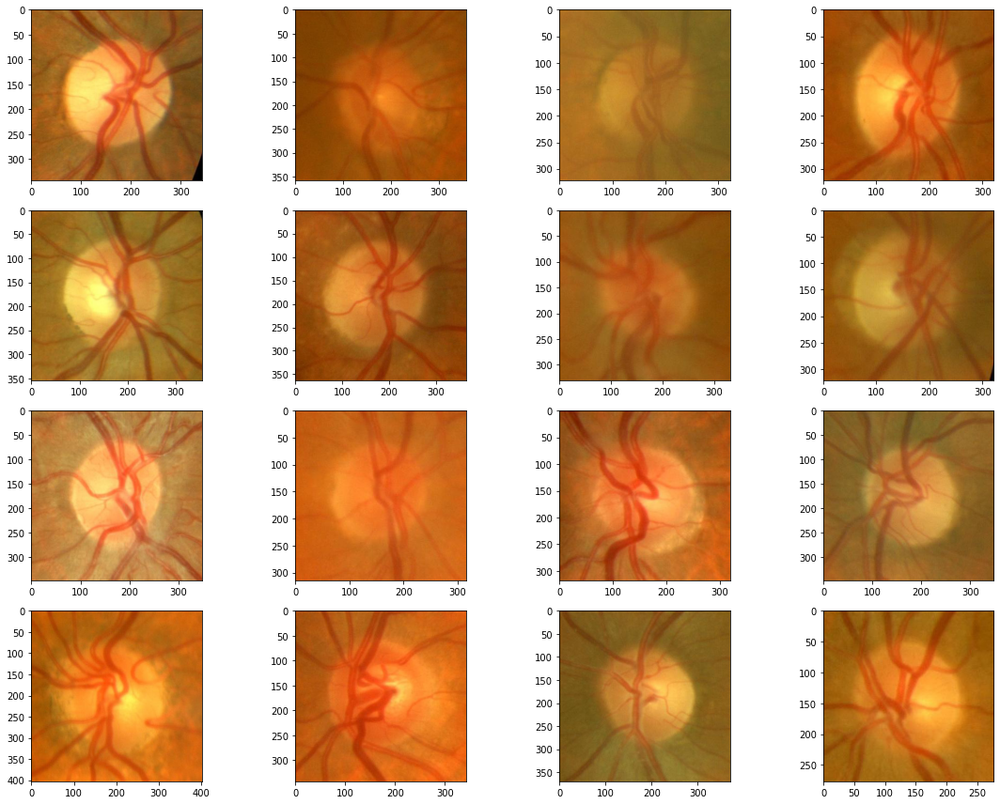

In [64]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [65]:
xception.write_examples(im_paths,1,1)

## Xception -- ORIGA

In [473]:
image_path = '/dataset/ORIGA/NotCropped'
y_pred, filenames, classification, classification_label = xception.classify(image_path)
xception.write_results(y_pred, 'origa', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 56s 676ms/step
650
[[0.5577958  0.44220415]
 [0.54713064 0.45286945]
 [0.57215005 0.42784998]
 ...
 [0.55905116 0.44094878]
 [0.57570755 0.42429242]
 [0.57074875 0.42925125]]
Writing Predictions to CSV...
Done.


In [474]:
df = xception.read_results('origa')

In [475]:
labels = list(df.columns[2:4])

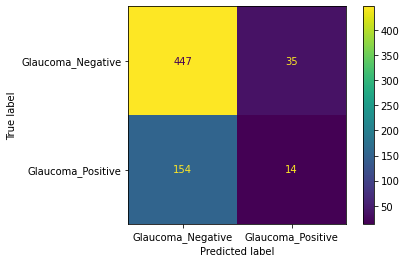

In [476]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

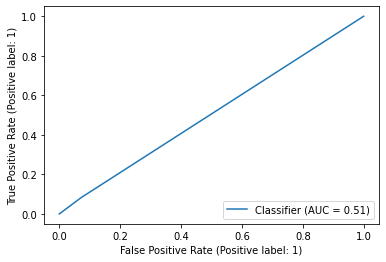

In [477]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

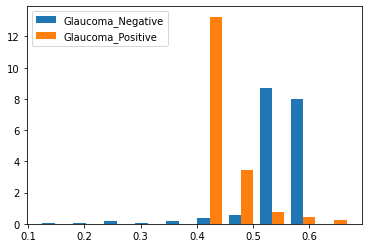

In [479]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## Xception - ORIGA - cropped

In [480]:
image_path = '/dataset/ORIGA/Cropped'
y_pred, filenames, classification, classification_label = xception.classify(image_path)
xception.write_results(y_pred, 'origa_cropped', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 18s 217ms/step
650
[[0.38948947 0.6105106 ]
 [0.87334734 0.1266525 ]
 [0.02024039 0.97975963]
 ...
 [0.8747145  0.12528546]
 [0.81819606 0.181804  ]
 [0.14013277 0.85986716]]
Writing Predictions to CSV...
Done.


In [481]:
df = xception.read_results('origa_cropped')

In [482]:
labels = list(df.columns[2:4])

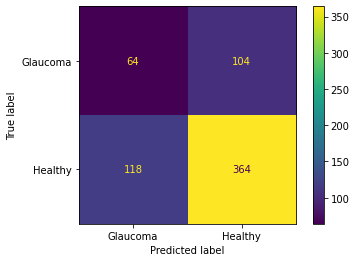

In [483]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

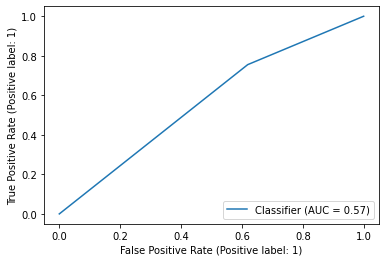

In [484]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

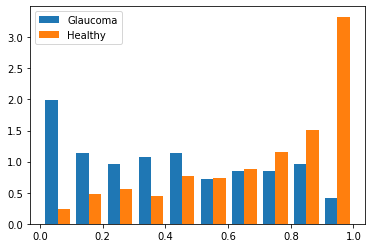

In [485]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## Xception - ORIGA - cropped larger

In [486]:
image_path = '/dataset/ORIGA/CroppedLarger'
y_pred, filenames, classification, classification_label = xception.classify(image_path)
xception.write_results(y_pred, 'origa_cropped_larger', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 18s 215ms/step
650
[[0.7119361  0.2880639 ]
 [0.8115925  0.18840745]
 [0.37007344 0.6299265 ]
 ...
 [0.8088805  0.19111949]
 [0.23431455 0.76568544]
 [0.06928372 0.9307163 ]]
Writing Predictions to CSV...
Done.


In [487]:
df = xception.read_results('origa_cropped_larger')

In [488]:
labels = list(df.columns[2:4])

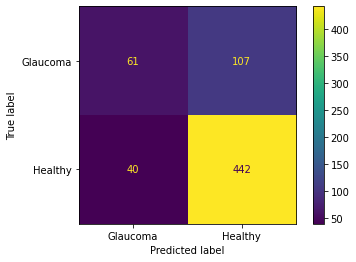

In [489]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

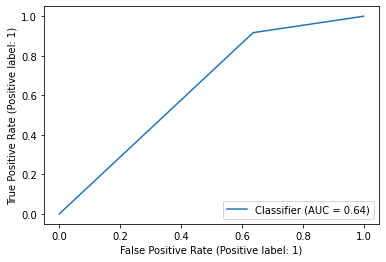

In [490]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

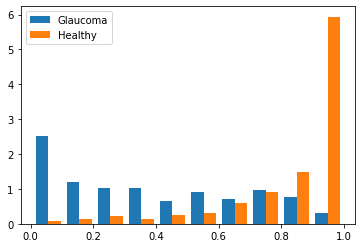

In [492]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## Xception - ORIGA - Diaz

In [493]:
image_path = '/dataset/ORIGA/CroppedDiaz'
y_pred, filenames, classification, classification_label = xception.classify(image_path)
xception.write_results(y_pred, 'origa_diaz', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 18s 217ms/step
650
[[0.479273   0.520727  ]
 [0.25875413 0.74124587]
 [0.35286713 0.6471329 ]
 ...
 [0.793818   0.20618193]
 [0.24626313 0.7537369 ]
 [0.06996591 0.9300341 ]]
Writing Predictions to CSV...
Done.


In [494]:
df = xception.read_results('origa_diaz')

In [495]:
labels = list(df.columns[2:4])

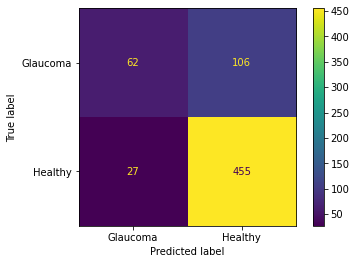

In [496]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

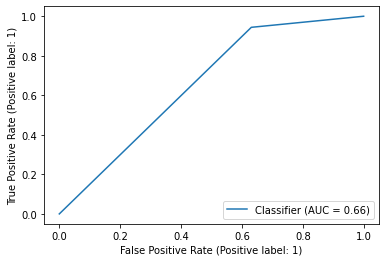

In [497]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

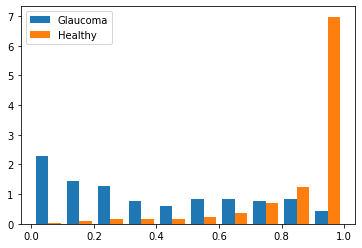

In [499]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

# VGG 16
## VGG 16 - RIM ONE DL

In [44]:
image_path = 'D:/MasterThesis/Datasets/RIM-ONE_DL_images/RIM-ONE_DL_images/partitioned_randomly/all_data'

In [45]:
y_pred, filenames, classification, classification_label = vgg16.classify(image_path)
vgg16.write_results(y_pred, 'rimone', filenames, classification, classification_label)

Found 485 images belonging to 2 classes.
61/61 [==============================] - 265s 4s/step
485
[[1.00000000e+00 5.45138228e-08]
 [9.68836963e-01 3.11630685e-02]
 [9.59255397e-01 4.07445431e-02]
 [3.36470872e-01 6.63529158e-01]
 [6.22649610e-01 3.77350390e-01]
 [5.28974891e-01 4.71025020e-01]
 [9.75689232e-01 2.43108105e-02]
 [9.98540759e-01 1.45919935e-03]
 [8.61221492e-01 1.38778552e-01]
 [6.03712499e-01 3.96287471e-01]
 [2.14869633e-01 7.85130382e-01]
 [7.73331463e-01 2.26668552e-01]
 [9.99617219e-01 3.82758502e-04]
 [9.85353708e-01 1.46462684e-02]
 [9.49527979e-01 5.04719540e-02]
 [9.99999762e-01 2.02989682e-07]
 [1.00000000e+00 1.05726032e-08]
 [9.51501787e-01 4.84981798e-02]
 [6.81804001e-01 3.18196028e-01]
 [7.20707417e-01 2.79292554e-01]
 [9.93888438e-01 6.11164980e-03]
 [9.99996066e-01 3.92359698e-06]
 [9.93029416e-01 6.97056856e-03]
 [4.35952395e-01 5.64047575e-01]
 [7.43595481e-01 2.56404489e-01]
 [9.99797046e-01 2.02949625e-04]
 [9.78777111e-01 2.12229248e-02]
 [9.946796

In [46]:
df = vgg16.read_results('rimone')

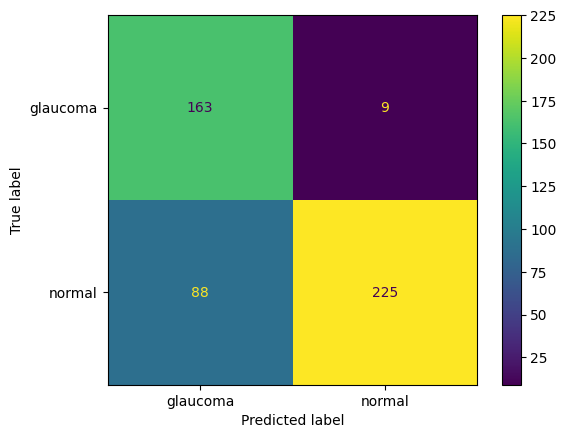

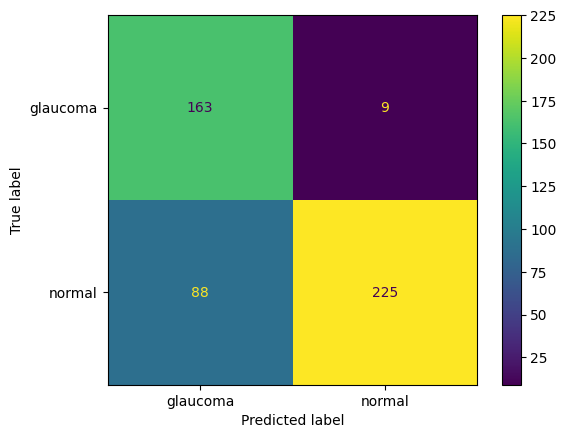

In [48]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)
plt.show()

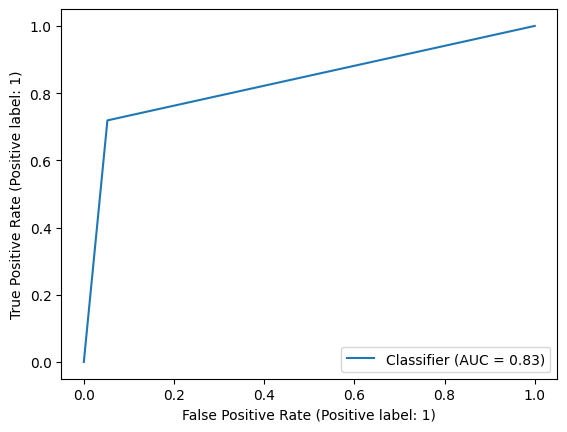

In [49]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])
plt.show()

## VGG 16 -- ACRIMA

In [500]:
image_path = '/dataset/ACRIMA'
y_pred, filenames, classification, classification_label = vgg16.classify(image_path)
vgg16.write_results(y_pred, 'acrima', filenames, classification, classification_label)

Found 705 images belonging to 2 classes.
89/89 [==============================] - 23s 257ms/step
705
[[9.1132617e-01 8.8673957e-02]
 [9.7026449e-01 2.9735457e-02]
 [9.9999613e-01 3.8568560e-06]
 ...
 [6.9901557e-03 9.9300987e-01]
 [8.3626010e-02 9.1637391e-01]
 [5.5817094e-02 9.4418287e-01]]
Writing Predictions to CSV...
Done.


In [11]:
df = vgg16.read_results('acrima')

In [12]:
labels = list(df.columns[2:4])

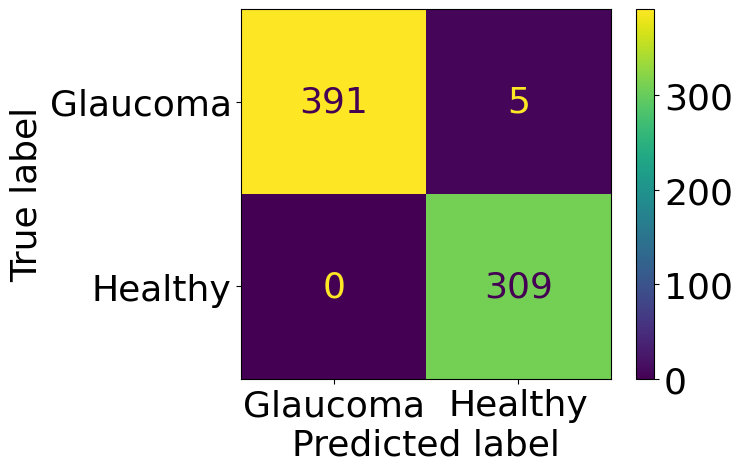

In [13]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

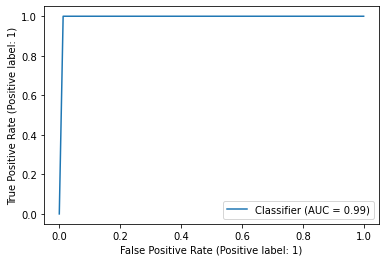

In [504]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

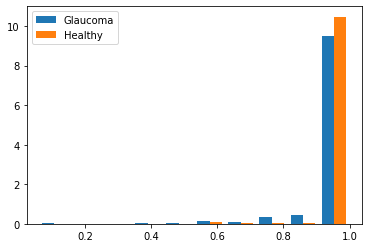

In [559]:
class_0, class_1 = Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

In [72]:
ex = Verify.n_examples(df, 0, False)

In [73]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
76,Im386_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
279,Im589_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
232,Im542_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
13,Im323_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
322,Im632_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
24,Im334_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
257,Im567_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
369,Im679_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
239,Im549_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
231,Im541_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0


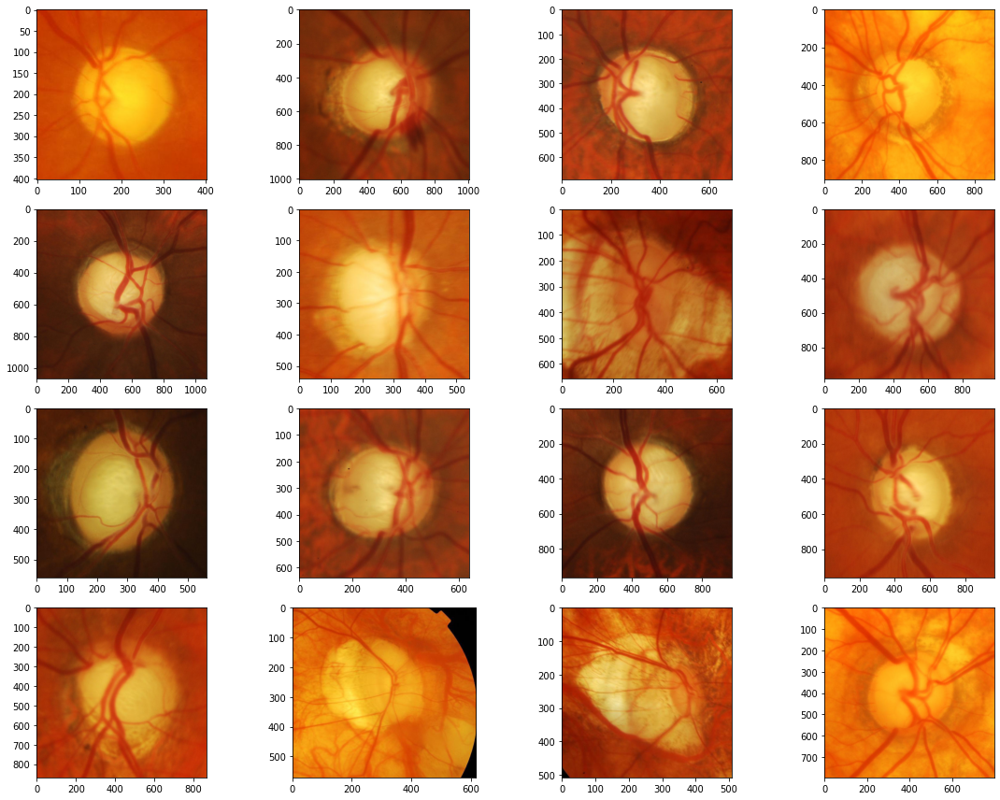

In [74]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [75]:
vgg16.write_examples(im_paths, 0, 0)

In [78]:
ex = Verify.n_examples(df, 0, True, 5)

In [79]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
112,Im422_g_ACRIMA.jpg,Glaucoma,0.06067,0.93933,0,1,"(0.06067, 0.93933)",0.06067,0.93933
288,Im598_g_ACRIMA.jpg,Glaucoma,0.12852,0.87148,0,1,"(0.12852, 0.87148)",0.12852,0.87148
286,Im596_g_ACRIMA.jpg,Glaucoma,0.42605,0.57395,0,1,"(0.42605, 0.57395)",0.42605,0.57395
107,Im417_g_ACRIMA.jpg,Glaucoma,0.44959,0.55041,0,1,"(0.44959, 0.55041)",0.44959,0.55041
309,Im619_g_ACRIMA.jpg,Glaucoma,0.47396,0.52604,0,1,"(0.47396, 0.52604)",0.47396,0.52604


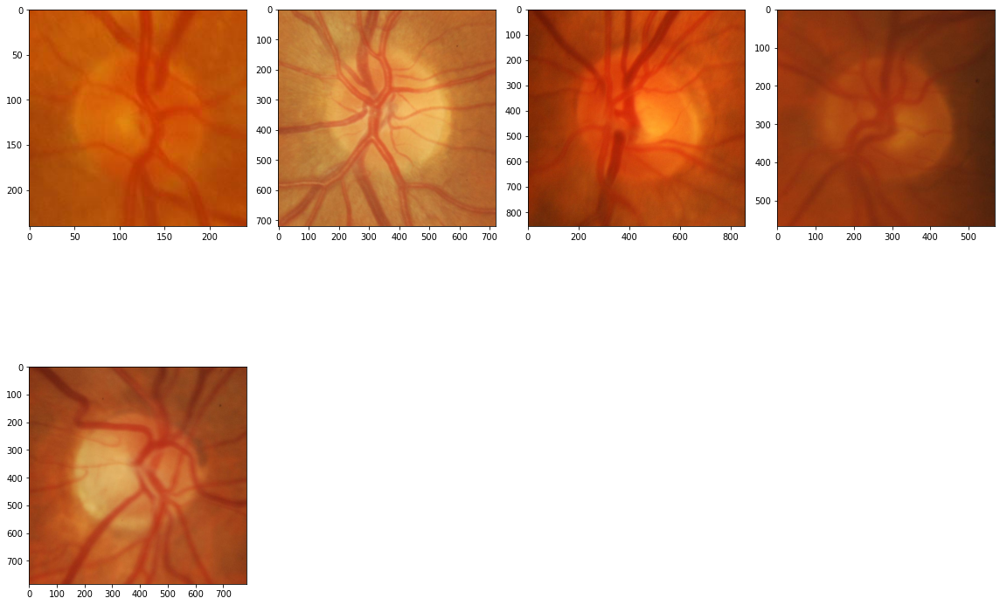

In [80]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [81]:
vgg16.write_examples(im_paths, 0, 1)

In [83]:
ex = Verify.n_examples(df, 1, False)

In [84]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
639,Im244_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
487,Im092_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
625,Im230_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
476,Im081_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
677,Im282_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
626,Im231_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
629,Im234_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
404,Im009_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
465,Im070_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
671,Im276_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0


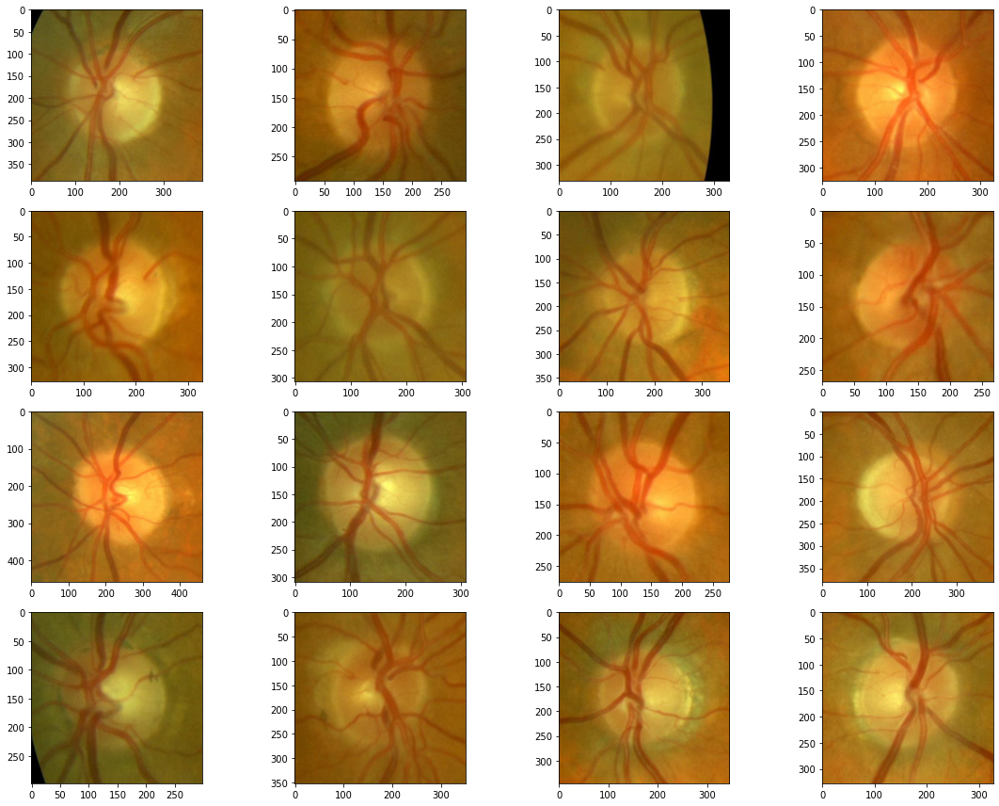

In [85]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [86]:
vgg16.write_examples(im_paths, 1, 1)

## VGG 16 - ORIGA

In [507]:
image_path = '/dataset/ORIGA/NotCropped'
y_pred, filenames, classification, classification_label = vgg16.classify(image_path)
vgg16.write_results(y_pred, 'origa', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 57s 695ms/step
650
[[0.6232     0.3768    ]
 [0.56421614 0.43578392]
 [0.781023   0.21897696]
 ...
 [0.20437343 0.7956265 ]
 [0.17632629 0.8236737 ]
 [0.20483334 0.7951666 ]]
Writing Predictions to CSV...
Done.


In [555]:
df = vgg16.read_results('origa')

In [509]:
labels = list(df.columns[2:4])

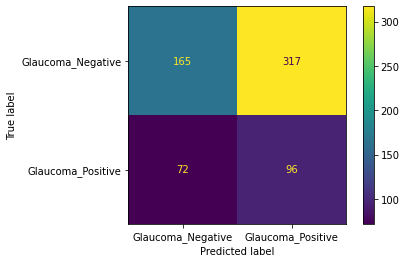

In [510]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

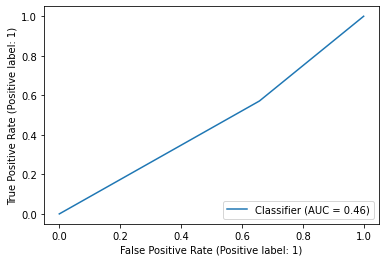

In [511]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

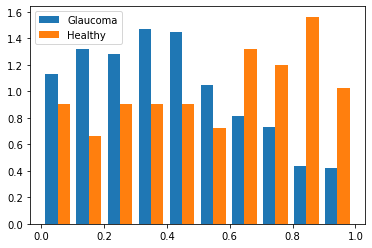

In [556]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## VGG 16 - ORIGA - cropped

In [513]:
image_path = '/dataset/ORIGA/Cropped'
y_pred, filenames, classification, classification_label = vgg16.classify(image_path)
vgg16.write_results(y_pred, 'origa_cropped', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 22s 262ms/step
650
[[4.5749149e-01 5.4250848e-01]
 [5.0418541e-02 9.4958138e-01]
 [4.2858049e-01 5.7141942e-01]
 ...
 [9.9684089e-01 3.1591514e-03]
 [9.9957186e-01 4.2808679e-04]
 [1.3618125e-01 8.6381876e-01]]
Writing Predictions to CSV...
Done.


In [514]:
df = vgg16.read_results('origa_cropped')

In [515]:
labels = list(df.columns[2:4])

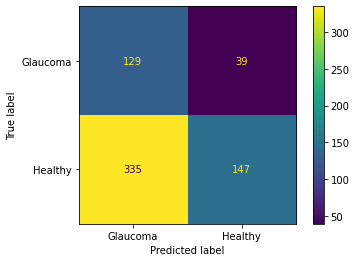

In [516]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

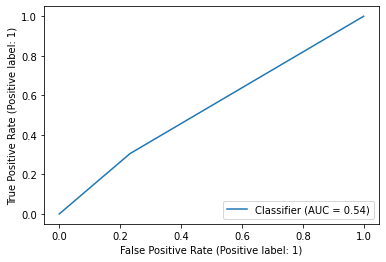

In [517]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

(array([0.45749, 0.05042, 0.42858, 0.9597 , 0.9999 , 0.17774, 0.9469 ,
        0.8252 , 0.88519, 0.81586, 0.99784, 0.80559, 0.99713, 0.96764,
        0.05872, 0.99946, 0.99979, 0.99962, 0.99536, 0.99274, 0.19167,
        0.05859, 0.04065, 0.22123, 0.99799, 0.30554, 0.96141, 0.97635,
        0.82809, 0.9902 , 0.43344, 0.99215, 0.98797, 0.96344, 0.88566,
        0.99959, 0.99587, 0.96349, 0.99674, 0.97074, 0.96671, 0.99997,
        0.96478, 0.69432, 0.99997, 0.99993, 0.99573, 0.98151, 0.96185,
        0.03637, 0.0746 , 0.61025, 0.9834 , 0.95252, 0.74171, 0.99998,
        0.89977, 0.97436, 0.0295 , 0.71884, 0.03154, 0.99683, 0.8674 ,
        0.85865, 0.43684, 0.00671, 0.35475, 0.95225, 0.94857, 0.99146,
        0.99793, 0.98138, 0.71352, 0.08525, 0.99806, 0.9997 , 0.95544,
        0.47073, 0.99995, 0.99628, 0.9717 , 0.9965 , 0.09996, 0.9923 ,
        0.63257, 0.76556, 0.70094, 0.99999, 0.99999, 0.49915, 0.99377,
        0.99534, 0.96619, 0.96079, 0.82324, 0.36097, 0.23048, 0.59948,
      

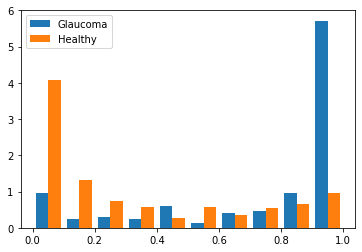

In [519]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)

## VGG16 - ORIGA - cropped larger

In [520]:
image_path = '/dataset/ORIGA/CroppedLarger'
y_pred, filenames, classification, classification_label = vgg16.classify(image_path)
vgg16.write_results(y_pred, 'origa_cropped_larger', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 21s 259ms/step
650
[[0.90527546 0.0947246 ]
 [0.27410856 0.7258914 ]
 [0.58829343 0.41170648]
 ...
 [0.99661666 0.00338319]
 [0.99820924 0.00179074]
 [0.00909138 0.99090856]]
Writing Predictions to CSV...
Done.


In [521]:
df = vgg16.read_results('origa_cropped_larger')

In [522]:
labels = list(df.columns[2:4])

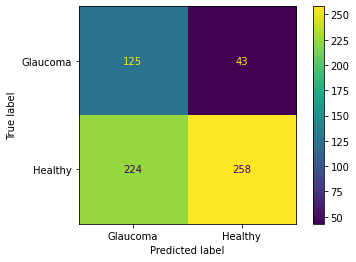

In [523]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

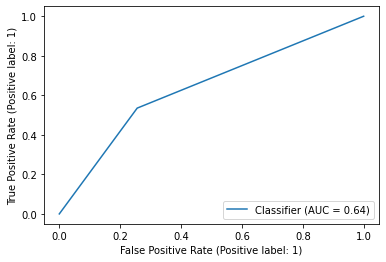

In [524]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

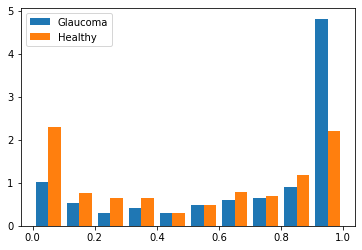

In [526]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## VGG 16 -- ORIGA - Diaz

In [574]:
image_path = '/dataset/ORIGA/CroppedDiaz'
y_pred, filenames, classification, classification_label = vgg16.classify(image_path)
vgg16.write_results(y_pred, 'origa_diaz', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 21s 253ms/step
650
[[0.9172608  0.08273921]
 [0.8919386  0.10806132]
 [0.56949073 0.43050936]
 ...
 [0.99504006 0.00495987]
 [0.9971034  0.00289665]
 [0.00824465 0.99175537]]
Writing Predictions to CSV...
Done.


In [576]:
df = vgg16.read_results('origa_diaz')

In [577]:
labels = list(df.columns[2:4])

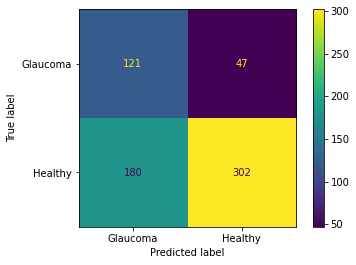

In [578]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

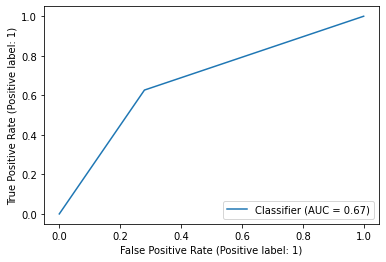

In [579]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

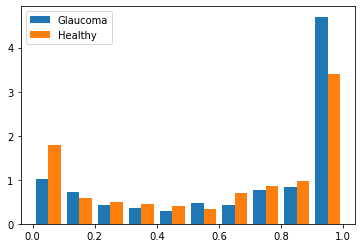

In [580]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

# VGG 19
## VGG 19 - RIM ONE DL

In [50]:
image_path = 'D:/MasterThesis/Datasets/RIM-ONE_DL_images/RIM-ONE_DL_images/partitioned_randomly/all_data'

In [53]:
y_pred, filenames, classification, classification_label = vgg19.classify(image_path)
vgg19.write_results(y_pred, 'rimone', filenames, classification, classification_label)

Found 485 images belonging to 2 classes.
61/61 [==============================] - 250s 4s/step
485
[[9.99999881e-01 1.02795831e-07]
 [9.96337533e-01 3.66249727e-03]
 [9.99982119e-01 1.78260198e-05]
 [7.95398772e-01 2.04601198e-01]
 [8.29342782e-01 1.70657203e-01]
 [9.24487591e-01 7.55124614e-02]
 [9.99712408e-01 2.87575327e-04]
 [9.99998808e-01 1.19270669e-06]
 [9.51546907e-01 4.84531634e-02]
 [9.98799562e-01 1.20048004e-03]
 [9.23754692e-01 7.62452781e-02]
 [9.35091317e-01 6.49086386e-02]
 [1.00000000e+00 2.35429765e-09]
 [9.99427855e-01 5.72114543e-04]
 [9.89256263e-01 1.07438061e-02]
 [1.00000000e+00 3.75116588e-16]
 [1.00000000e+00 1.30566324e-17]
 [9.92459118e-01 7.54089002e-03]
 [9.09393668e-01 9.06063765e-02]
 [9.84214425e-01 1.57856364e-02]
 [9.99998569e-01 1.46244986e-06]
 [1.00000000e+00 8.06451802e-13]
 [9.99961257e-01 3.87070322e-05]
 [8.27989638e-01 1.72010362e-01]
 [9.97678816e-01 2.32117833e-03]
 [1.00000000e+00 5.09759381e-08]
 [9.98138905e-01 1.86113466e-03]
 [9.999985

In [54]:
df = vgg19.read_results('rimone')

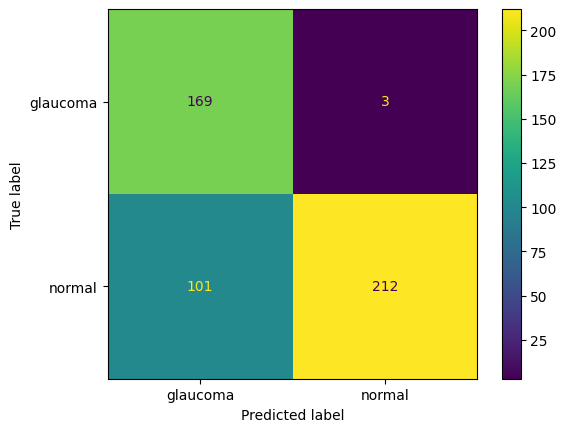

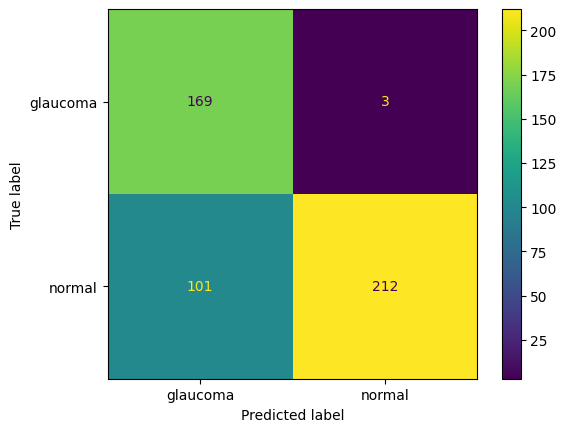

In [56]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)
plt.show()

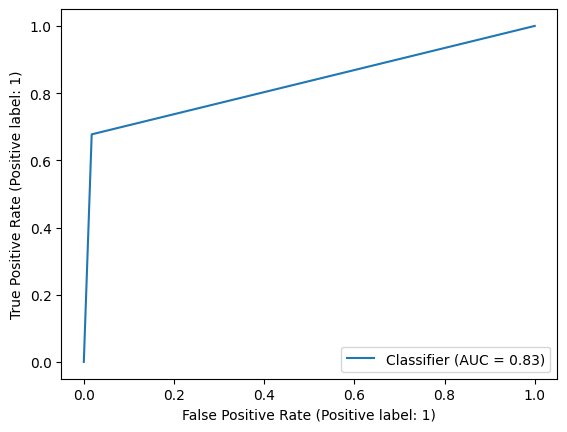

In [57]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])
plt.show()

## VGG 19 -- ACRIMA

In [59]:
image_path = '../Datasets/ACRIMA'
y_pred, filenames, classification, classification_label = vgg19.classify(image_path)
vgg19.write_results(y_pred, 'acrima', filenames, classification, classification_label)

Found 705 images belonging to 2 classes.
89/89 [==============================] - 224s 3s/step
705
[[9.8871720e-01 1.1282759e-02]
 [9.9979955e-01 2.0042430e-04]
 [1.0000000e+00 4.3784498e-10]
 ...
 [3.8854772e-04 9.9961144e-01]
 [1.8369786e-01 8.1630212e-01]
 [1.9298044e-01 8.0701953e-01]]
Writing Predictions to CSV...
Done.


In [14]:
df = vgg19.read_results('acrima')

In [583]:
labels = list(df.columns[2:4])

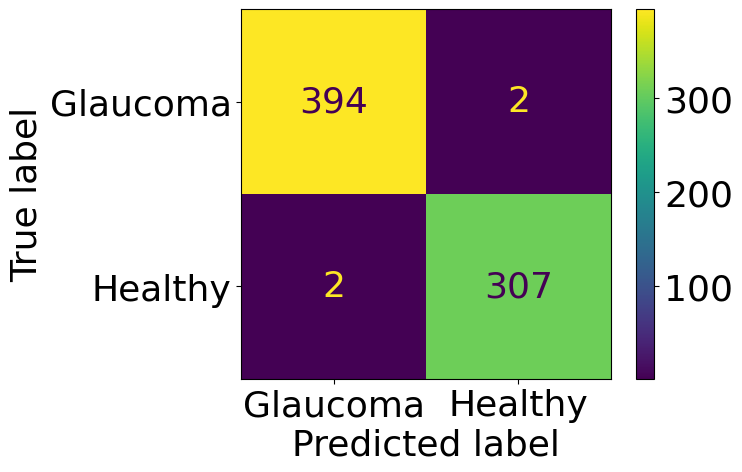

In [15]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

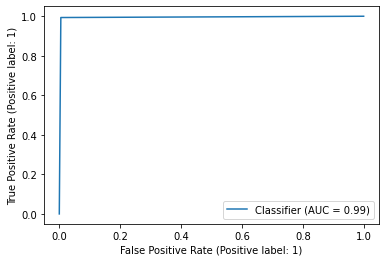

In [586]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

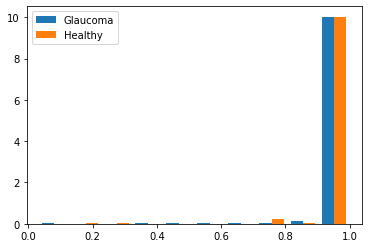

In [632]:
class_0, class_1 = Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)

In [88]:
ex = Verify.n_examples(df, 0, False)

In [89]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
197,Im507_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
249,Im559_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
261,Im571_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
260,Im570_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
259,Im569_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
257,Im567_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
256,Im566_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
254,Im564_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
253,Im563_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
251,Im561_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0


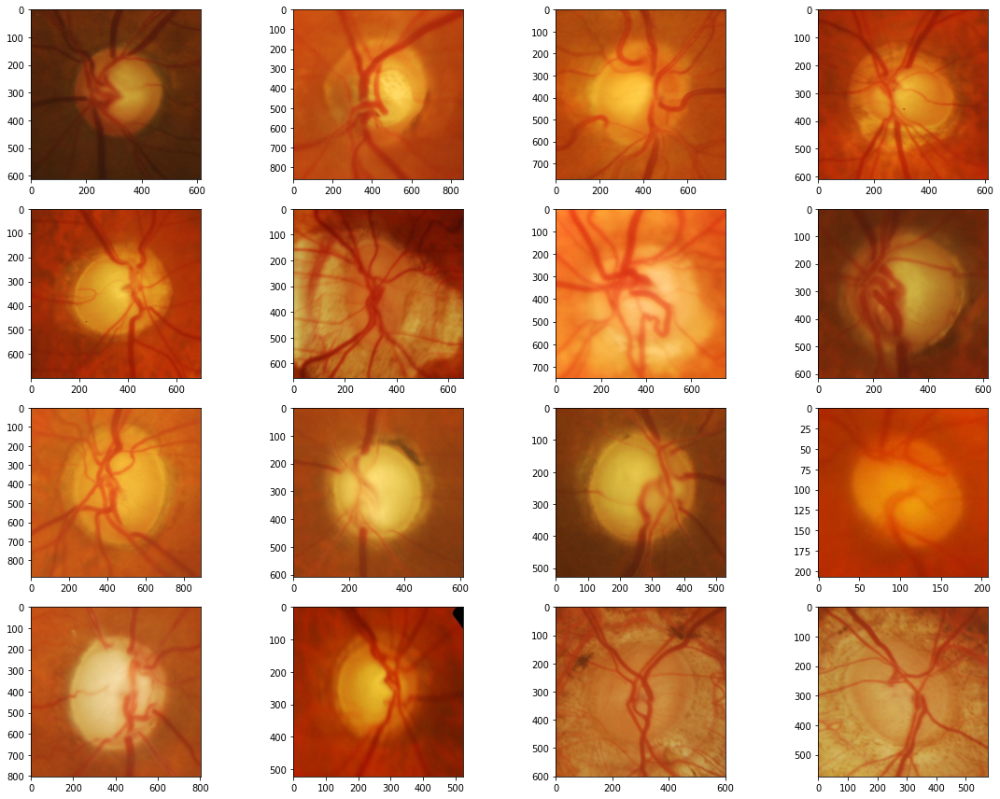

In [90]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [91]:
vgg19.write_examples(im_paths, 0, 0)

In [94]:
ex = Verify.n_examples(df, 0, True, 2)

In [95]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
392,Im702_g_ACRIMA.JPG,Glaucoma,0.03282,0.96718,0,1,"(0.03282, 0.96718)",0.03282,0.96718
288,Im598_g_ACRIMA.jpg,Glaucoma,0.35168,0.64832,0,1,"(0.35168, 0.64832)",0.35168,0.64832


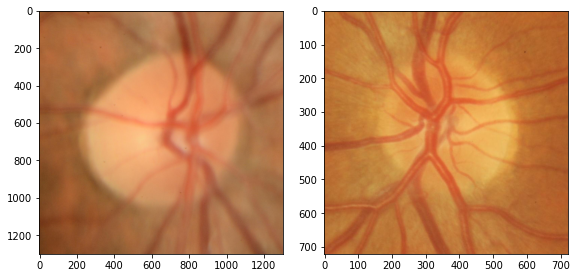

In [96]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [97]:
vgg19.write_examples(im_paths, 0, 1)

In [98]:
ex = Verify.n_examples(df, 1, False)

In [99]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
626,Im231_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
462,Im067_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
621,Im226_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
622,Im227_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
623,Im228_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
571,Im176_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
627,Im232_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
628,Im233_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
629,Im234_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0
468,Im073_ACRIMA.jpg,Healthy,0.0,1.0,1,1,"(0.0, 1.0)",0.0,1.0


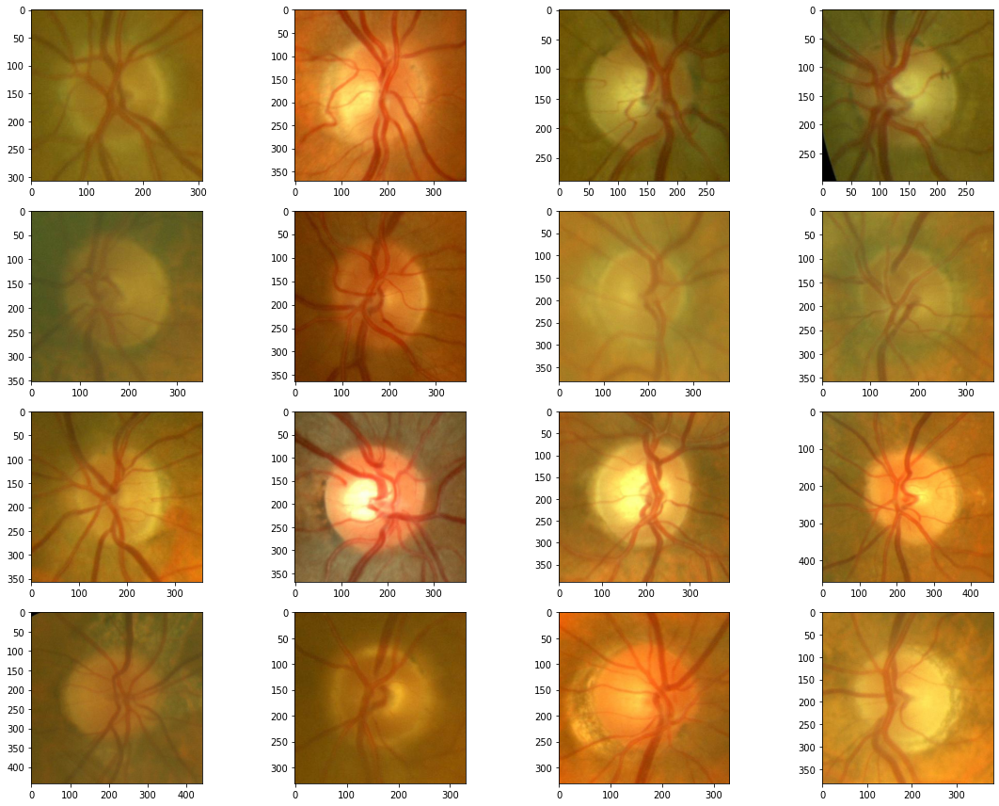

In [100]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [101]:
vgg19.write_examples(im_paths, 1, 1)

In [108]:
ex = Verify.n_examples(df, 1, True, 2)

In [109]:
ex

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
611,Im216_ACRIMA.jpg,Healthy,0.83871,0.16129,1,0,"(0.83871, 0.16129)",0.83871,0.16129
530,Im135_ACRIMA.jpg,Healthy,0.70490,0.29510,1,0,"(0.7049, 0.2951)",0.70490,0.29510


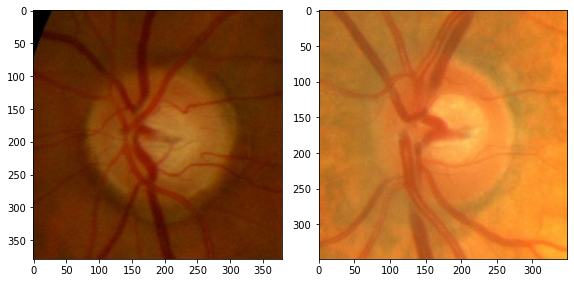

In [110]:
im_paths = Verify.visualize_examples(image_path, ex['image_name'])

In [112]:
im_paths

['/dataset/ACRIMA/Healthy/Im216_ACRIMA.jpg',
 '/dataset/ACRIMA/Healthy/Im135_ACRIMA.jpg']

In [113]:
vgg19.write_examples(im_paths, 1, 0)

VGG19 model seems to be sensitive to illumination and color balance (yellowish -> glaucoma, greenish -> healthy)

## VGG19 -- ORIGA

In [642]:
image_path = '/dataset/ORIGA/NotCropped'
y_pred, filenames, classification, classification_label = vgg19.classify(image_path)
vgg19.write_results(y_pred, 'origa', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 60s 724ms/step
650
[[9.9999946e-01 4.8984293e-07]
 [9.9999994e-01 3.5042699e-08]
 [9.9999994e-01 1.4910471e-08]
 ...
 [9.1069746e-01 8.9302443e-02]
 [1.0000000e+00 3.5719869e-09]
 [9.9999881e-01 1.2458912e-06]]
Writing Predictions to CSV...
Done.


In [643]:
df = vgg19.read_results('origa')

In [644]:
labels = list(df.columns[2:4])

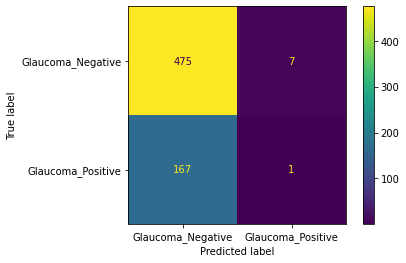

In [645]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

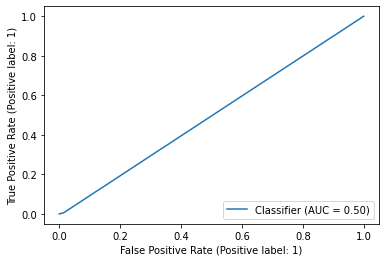

In [646]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

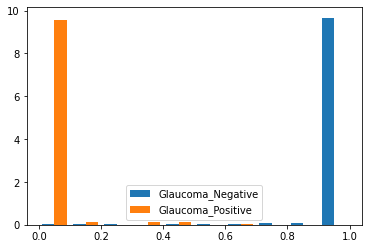

In [648]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## VGG 19 - ORIGA - cropped

In [649]:
image_path = '/dataset/ORIGA/Cropped'
y_pred, filenames, classification, classification_label = vgg19.classify(image_path)
vgg19.write_results(y_pred, 'origa_cropped', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 26s 310ms/step
650
[[9.9030137e-01 9.6986759e-03]
 [7.8596944e-01 2.1403058e-01]
 [6.4510828e-01 3.5489163e-01]
 ...
 [9.9992245e-01 7.7444922e-05]
 [1.0000000e+00 1.4056980e-08]
 [7.3758113e-01 2.6241890e-01]]
Writing Predictions to CSV...
Done.


In [650]:
df = vgg19.read_results('origa_cropped')

In [651]:
labels = list(df.columns[2:4])

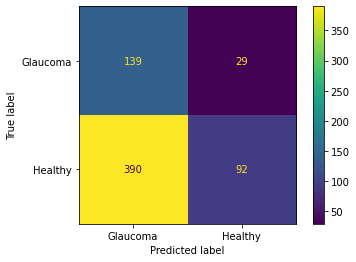

In [652]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

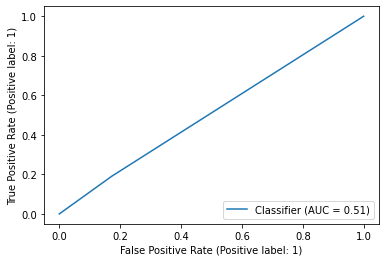

In [653]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

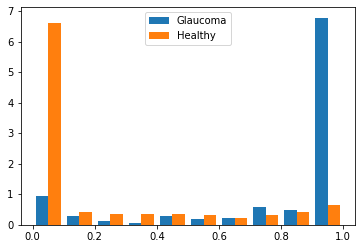

In [654]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## VGG 19 - ORIGA - cropped larger

In [655]:
image_path = '/dataset/ORIGA/CroppedLarger'
y_pred, filenames, classification, classification_label = vgg19.classify(image_path)
vgg19.write_results(y_pred, 'origa_cropped_larger', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 26s 319ms/step
650
[[9.96416271e-01 3.58361076e-03]
 [9.66258585e-01 3.37413400e-02]
 [7.46309757e-01 2.53690213e-01]
 ...
 [9.99881685e-01 1.18210104e-04]
 [9.99998927e-01 1.04060291e-06]
 [5.21525443e-02 9.47847426e-01]]
Writing Predictions to CSV...
Done.


In [656]:
df = vgg19.read_results('origa_cropped_larger')

In [657]:
labels = list(df.columns[2:4])

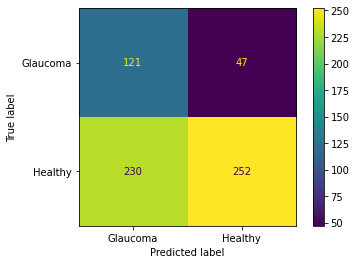

In [658]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

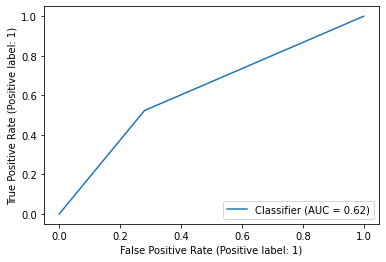

In [659]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

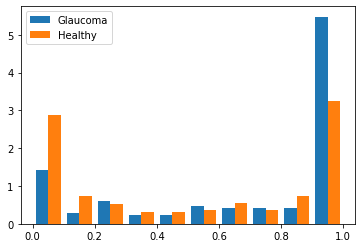

In [661]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

## VGG 19 - Cropped - Diaz

In [662]:
image_path = '/dataset/ORIGA/CroppedDiaz'
y_pred, filenames, classification, classification_label = vgg19.classify(image_path)
vgg19.write_results(y_pred, 'origa_diaz', filenames, classification, classification_label)

Found 650 images belonging to 2 classes.
82/82 [==============================] - 26s 317ms/step
650
[[9.84338760e-01 1.56612452e-02]
 [8.95312309e-01 1.04687706e-01]
 [5.94743550e-01 4.05256450e-01]
 ...
 [9.99294996e-01 7.04965089e-04]
 [9.99997854e-01 2.14983675e-06]
 [5.81138534e-03 9.94188666e-01]]
Writing Predictions to CSV...
Done.


In [663]:
df = vgg19.read_results('origa_diaz')

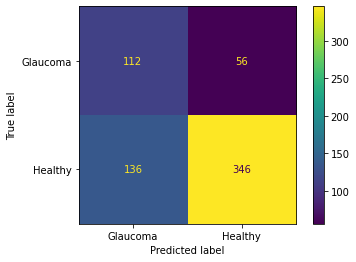

In [664]:
Verify.confusion(_y_pred=df['y_pred'],
                 _y_true=df['y_true'],
                 display_labels=labels)

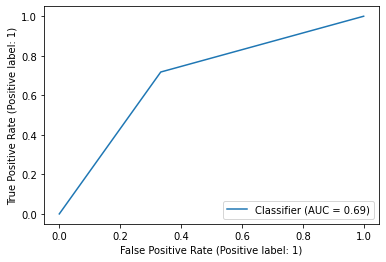

In [665]:
Verify.roc(_y_pred=df['y_pred'],
           _y_true=df['y_true'])

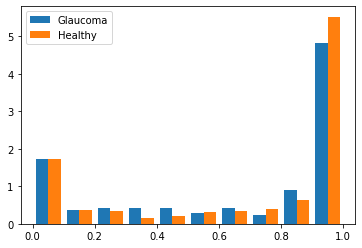

In [666]:
Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

# XAI

## Setup

In [457]:
!pip install explainerdashboard

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.9/286.9 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 220.6/220.6 kB 31.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.6/96.6 kB 25.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.7/57.7 kB 15.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.5/90.5 kB 21.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 42.5 MB/s eta 0:00:0000:010:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 575.9/575.9 kB 39.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.3/15.3 MB 37.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.8/101.8 kB 25.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.2/317.2 kB 35.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 19.5 MB/s eta 0:00:00
     ━━━━

In [458]:
resnet50.model

In [ ]:
image_path = '/dataset/ACRIMA'

In [464]:
data = tf.keras.utils.image_dataset_from_directory(image_path)

Found 705 files belonging to 2 classes.


In [476]:
x_test = [images for images, labels in data.unbatch()]

In [479]:
y_test = [labels for images, labels in data.unbatch()]

In [480]:
from explainerdashboard import ClassifierExplainer, ExplainerDashboard

In [481]:
explainer = ClassifierExplainer(resnet50.model, x_test, y_test)

AttributeError: 'list' object has no attribute 'columns'

In [482]:
!pip install tf-explain

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 8.1 MB/s eta 0:00:00


In [523]:
!pip install opencv-python

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.8/61.8 MB 15.3 MB/s eta 0:00:0000:0100:01


In [539]:
!apt-get update

Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease [1581 B]
Hit:2 http://archive.ubuntu.com/ubuntu focal InRelease                         
Hit:3 http://security.ubuntu.com/ubuntu focal-security InRelease
Err:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease
  The following signatures couldn't be verified because the public key is not available: NO_PUBKEY A4B469963BF863CC
Get:4 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Get:5 http://archive.ubuntu.com/ubuntu focal-backports InRelease [108 kB]
Ign:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu2004/x86_64  InRelease
Get:7 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu2004/x86_64  Release [564 B]
Reading package lists... Done  
W: GPG error: https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease: The following signatures couldn't be verified because

In [544]:
!apt-get install libglib2.0-0

Reading package lists... Done
Building dependency tree       
Reading state information... Done
libglib2.0-0 is already the newest version (2.64.6-1~ubuntu20.04.4).
0 upgraded, 0 newly installed, 0 to remove and 148 not upgraded.


In [543]:
!dpkg --configure -a

Setting up tzdata (2022g-0ubuntu0.20.04.1) ...
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76.)
debconf: falling back to frontend: Readline

Current default time zone: 'Etc/UTC'
Local time is now:      Wed Apr  5 12:01:52 UTC 2023.
Universal Time is now:  Wed Apr  5 12:01:52 UTC 2023.
Run 'dpkg-reconfigure tzdata' if you wish to change it.

Setting up libglib2.0-data (2.64.6-1~ubuntu20.04.4) ...
Setting up libicu66:amd64 (66.1-2ubuntu2.1) ...
Setting up libxml2:amd64 (2.9.10+dfsg-5ubuntu0.20.04.5) ...
Setting up shared-mime-info (1.15-1) ...
Processing triggers for libc-bin (2.31-0ubuntu9.1) ...


## Experiments

### GradCAM

In [29]:
import cv2
import tensorflow as tf
from tf_explain.core.grad_cam import GradCAM

In [226]:
def overlay_heatmap(heatmap, image, alpha=0.5,
                    colormap=cv2.COLORMAP_JET):
    # apply the supplied color map to the heatmap and then
    # overlay the heatmap on the input image
    heatmap = cv2.applyColorMap(heatmap, colormap)
    output = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)
    # return a 2-tuple of the color mapped heatmap and the output,
    # overlaid image
    return (heatmap, output)

In [676]:
image_path = '/dataset/ACRIMA'

In [668]:
df = resnet50.read_results('acrima')

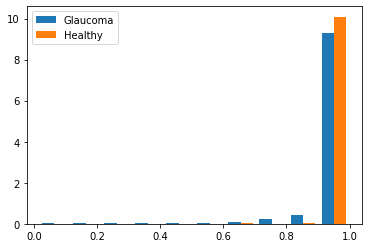

In [669]:
class_0, class_1 = Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

In [670]:
ex = Verify.examples(df, class_0, 0, False, 0.00001)

In [673]:
len(ex)

14

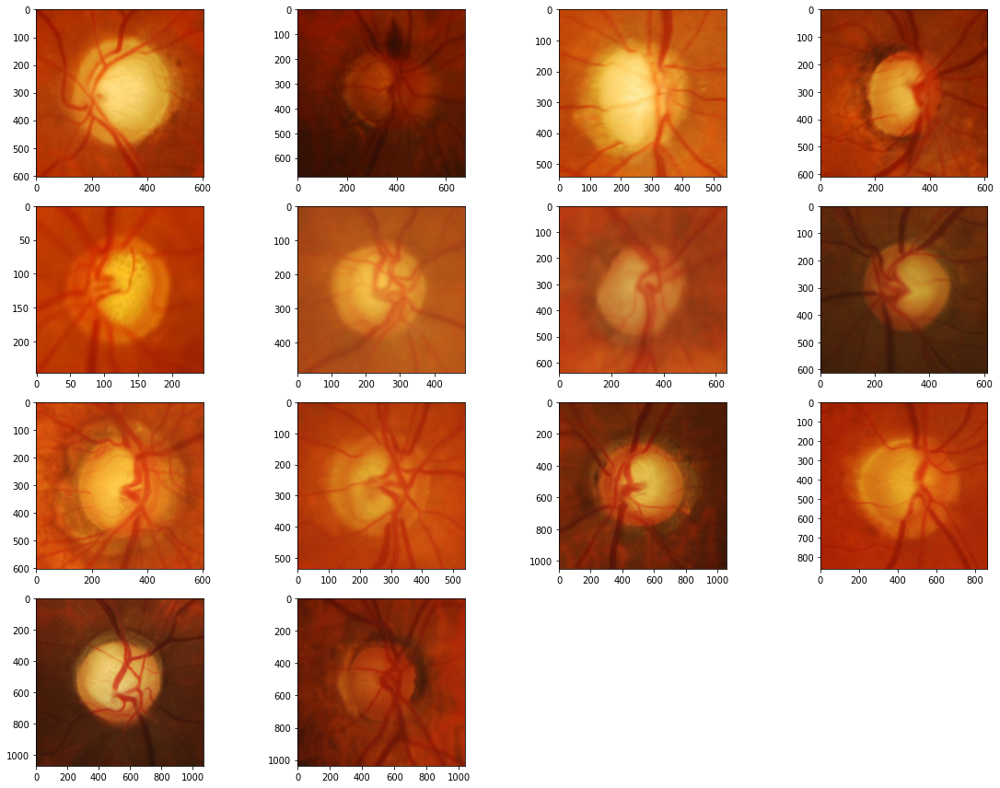

In [677]:
im_paths = Verify.visualize_examples(image_path, ex)

In [685]:
x = resnet50.paths_to_dataset(im_paths)
resnet50.model.predict(x)

1/1 [==============================] - 1s 1s/step


array([[0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [0.99999994, 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ],
       [1.        , 0.        ]], dtype=float32)

In [686]:
explainer = GradCAM()

In [696]:
x/255

array([[[[0.54509807, 0.09019608, 0.        ],
         [0.54901963, 0.09411765, 0.        ],
         [0.5529412 , 0.09803922, 0.        ],
         ...,
         [0.6392157 , 0.17254902, 0.00392157],
         [0.6392157 , 0.17254902, 0.00392157],
         [0.6392157 , 0.17254902, 0.00784314]],

        [[0.5529412 , 0.08627451, 0.00784314],
         [0.5529412 , 0.08627451, 0.        ],
         [0.5529412 , 0.08627451, 0.        ],
         ...,
         [0.6392157 , 0.17254902, 0.00392157],
         [0.6392157 , 0.17254902, 0.00392157],
         [0.6392157 , 0.17254902, 0.00784314]],

        [[0.5568628 , 0.08235294, 0.00784314],
         [0.5529412 , 0.07843138, 0.00392157],
         [0.54901963, 0.07450981, 0.        ],
         ...,
         [0.6392157 , 0.17254902, 0.00392157],
         [0.6392157 , 0.17254902, 0.00392157],
         [0.6392157 , 0.17254902, 0.00784314]],

        ...,

        [[0.7294118 , 0.16862746, 0.        ],
         [0.7294118 , 0.1764706 , 0.00784314]

In [691]:
heatmap = explainer.explain(validation_data=(x/255.0, None),
                            model=resnet50.model,
                            class_index=0,
                            layer_name='add_16')

In [692]:
heatmap.shape

(896, 896, 3)

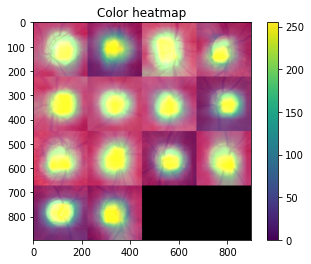

In [697]:
plt.figure()
plt.imshow(heatmap)
plt.colorbar()
plt.title('Color heatmap')
plt.show()

In [698]:
ex = Verify.examples(df, class_0, 0, True, 0.2)

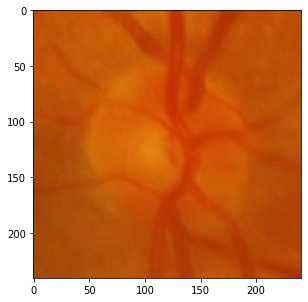

In [699]:
im_paths = Verify.visualize_examples(image_path, ex)

In [700]:
x = resnet50.paths_to_dataset(im_paths)
resnet50.model.predict(x)

1/1 [==============================] - 0s 59ms/step


array([[1., 0.]], dtype=float32)

In [701]:
x.shape

(1, 224, 224, 3)

In [702]:
heatmap = explainer.explain(validation_data=(x/255.0, None),
                            model=resnet50.model,
                            class_index=0,
                            layer_name='add_16')

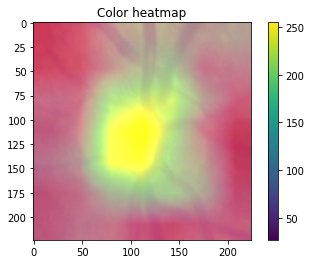

In [703]:
plt.figure()
plt.imshow(heatmap)
plt.colorbar()
plt.title('Color heatmap')
plt.show()

In [704]:
df = xception.read_results('acrima')

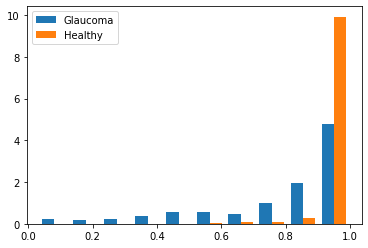

In [705]:
class_0, class_1 = Verify.certainty(_y_prob=df['y_prob'], _y_true=df['y_true'], density=True, label=labels)
plt.show()

In [706]:
ex = Verify.examples(df, class_0, 0, False, 0.005)

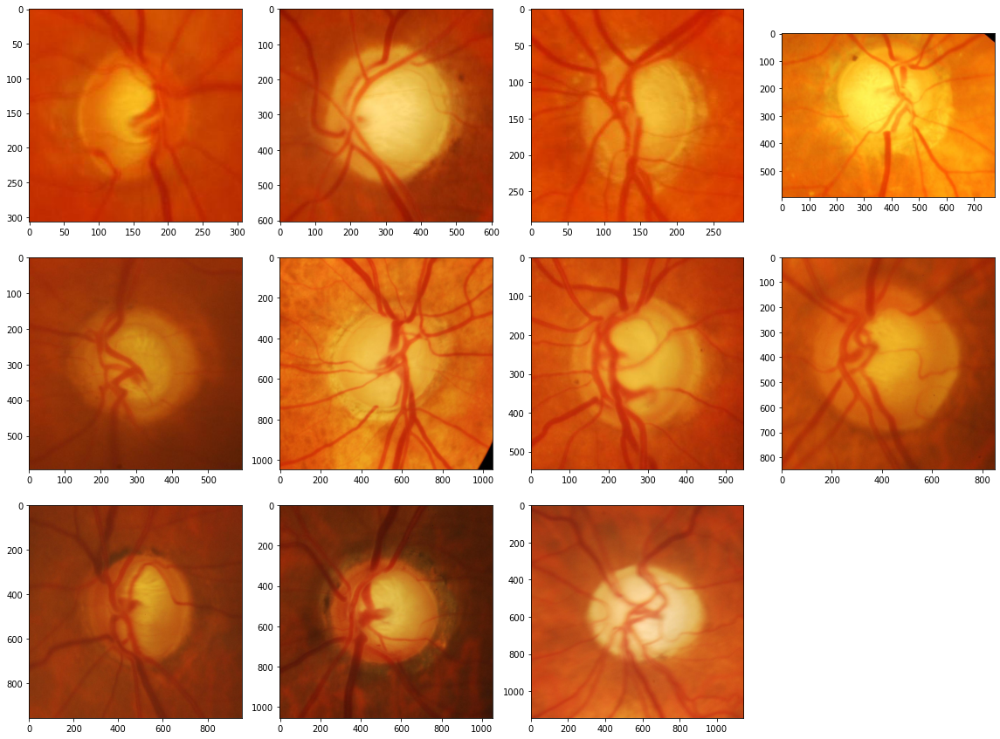

In [707]:
im_paths = Verify.visualize_examples(image_path, ex)

In [708]:
x = xception.paths_to_dataset(im_paths)
xception.model.predict(x)

1/1 [==============================] - 1s 1s/step


array([[0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 1.0000000e+00],
       [9.2917581e-19, 1.0000000e+00],
       [0.0000000e+00, 1.0000000e+00]], dtype=float32)

In [711]:
xception.model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 149, 149, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 149, 149, 32  128        ['block1_conv1[0][0]']           
 ation)                         )                                                           

In [712]:
heatmap = explainer.explain(validation_data=(x/255.0, None),
                            model=xception.model,
                            class_index=0,
                            layer_name='add_12')

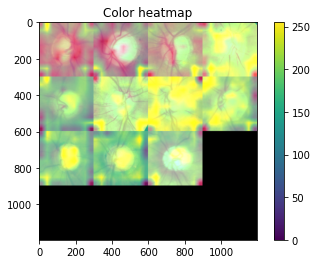

In [713]:
plt.figure()
plt.imshow(heatmap)
plt.colorbar()
plt.title('Color heatmap')
plt.show()

In [714]:
ex = Verify.examples(df, class_0, 0, True, 0.2)

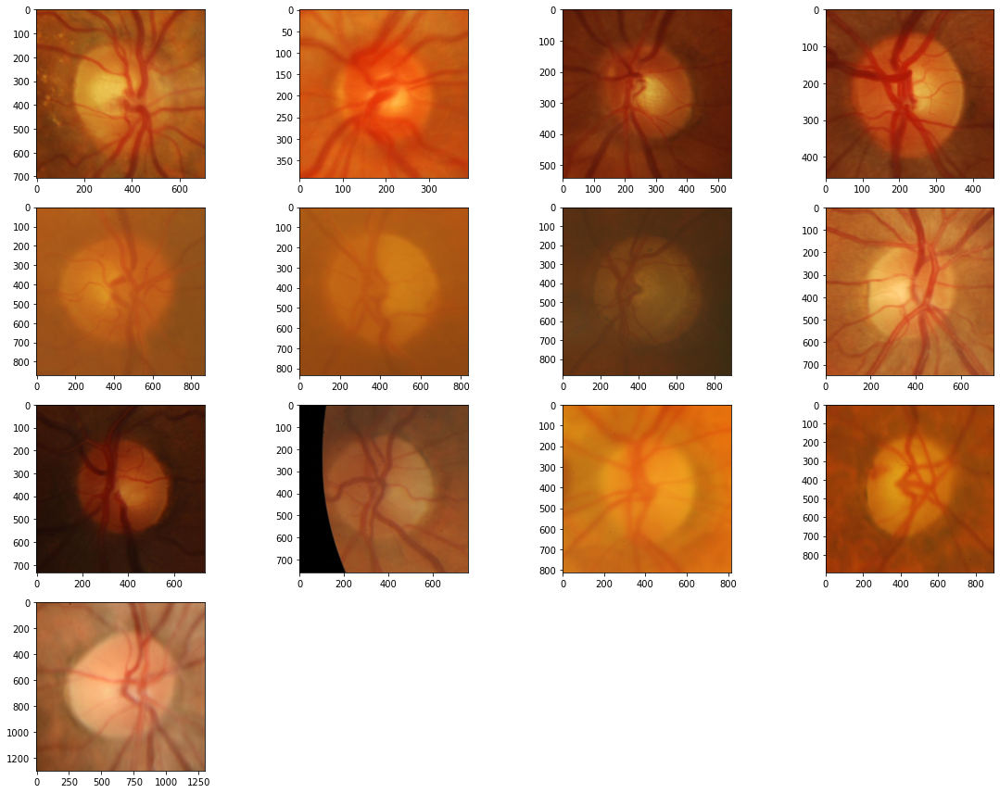

In [715]:
im_paths = Verify.visualize_examples(image_path, ex)

In [716]:
x = xception.paths_to_dataset(im_paths)
xception.model.predict(x)

1/1 [==============================] - 0s 461ms/step


array([[0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [0.0000000e+00, 9.9999994e-01],
       [1.1189820e-37, 1.0000000e+00],
       [0.0000000e+00, 1.0000000e+00],
       [0.0000000e+00, 1.0000000e+00],
       [0.0000000e+00, 1.0000000e+00],
       [0.0000000e+00, 1.0000000e+00]], dtype=float32)

In [717]:
heatmap = explainer.explain(validation_data=(x/255.0, None),
                            model=xception.model,
                            class_index=0,
                            layer_name='add_12')

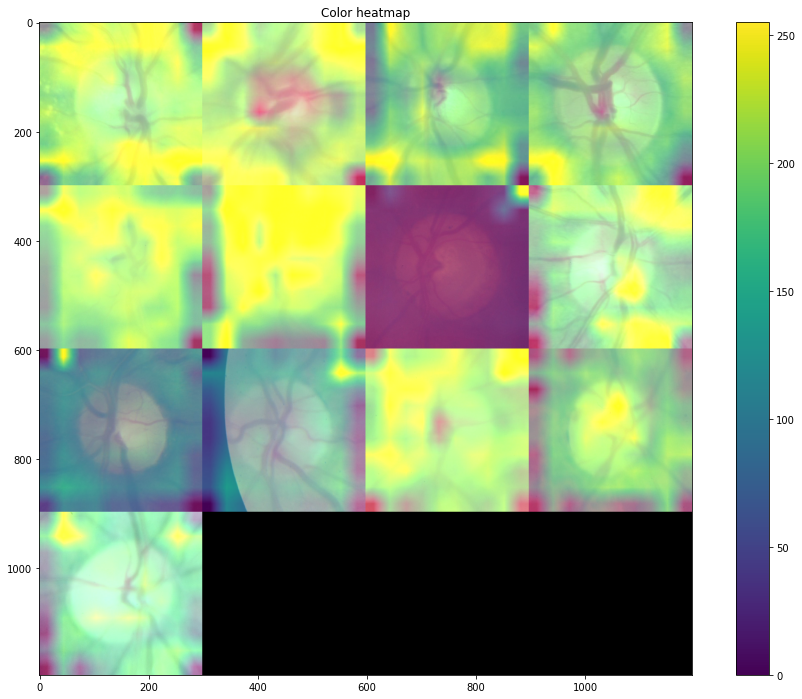

In [719]:
plt.figure(figsize=(16,12))
plt.imshow(heatmap)
plt.colorbar()
plt.title('Color heatmap')
plt.show()

In [77]:
example = x[0]

In [78]:
example.shape

(224, 224, 3)

In [79]:
example = np.expand_dims(example, axis=0)

In [80]:
example.shape

(1, 224, 224, 3)

In [81]:
resnet50.model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_1 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_1[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1 (Conv2D)                 (None, 112, 112, 64  9472        ['zero_padding2d_1[0][0]']       
                                )                                                           

In [114]:
val_data = example.copy()

In [287]:
heatmap = explainer.explain(validation_data=(val_data/255.0, None),
                            model=resnet50.model,
                            class_index=0,
                            layer_name='add_16')

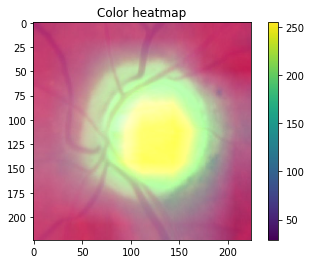

In [288]:
plt.figure()
plt.imshow(heatmap)
plt.colorbar()
plt.title('Color heatmap')
plt.show()

In [289]:
heatmap_gray = cv2.cvtColor(heatmap, cv2.COLOR_RGB2GRAY)

In [293]:
heatmap_gray.shape

(224, 224)

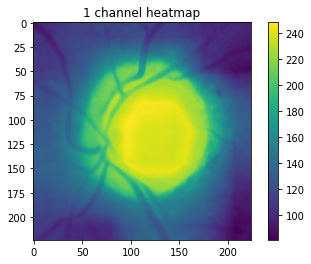

In [294]:
plt.figure()
plt.imshow(heatmap_gray, cmap='viridis')
plt.colorbar()
plt.title('1 channel heatmap')
plt.show()

In [295]:
image = x[0].astype(np.uint8)

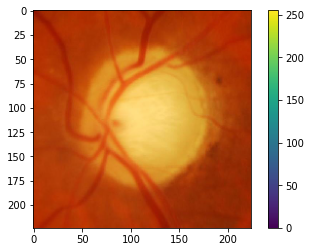

In [296]:
plt.figure()
plt.imshow(image)
plt.colorbar()
plt.show()

In [297]:
image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

In [298]:
heatmap_gray.shape

(224, 224)

In [299]:
image_gray.shape

(224, 224)

In [300]:
heatmap_corr = cv2.cvtColor(heatmap_gray, cv2.COLOR_GRAY2RGB)
image_corr = cv2.cvtColor(image_gray, cv2.COLOR_GRAY2RGB)

In [301]:
output = np.hstack([image_corr, heatmap_corr])

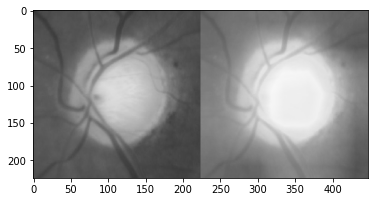

In [302]:
plt.figure()
plt.imshow(output)
plt.show()

In [303]:
_, output = overlay_heatmap(heatmap_corr, image_corr, alpha=0.5)

In [304]:
output = np.hstack([image, output])

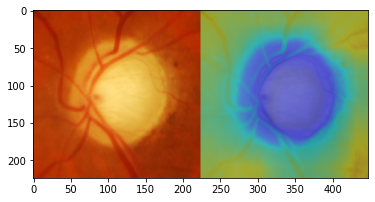

In [305]:
plt.figure()
plt.imshow(output)
plt.show()

In [306]:
_, output = overlay_heatmap(heatmap, image, alpha=0.4)

In [307]:
output = np.hstack([image, output])

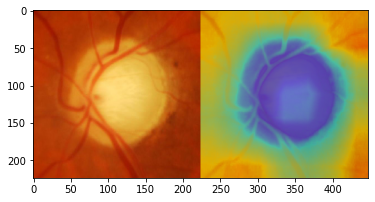

In [308]:
plt.figure()
plt.imshow(output)
plt.show()

In [309]:
alpha_params = np.linspace(0,1,11)[1:]

In [310]:
alpha_params

array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ])

Importance of correct colormap

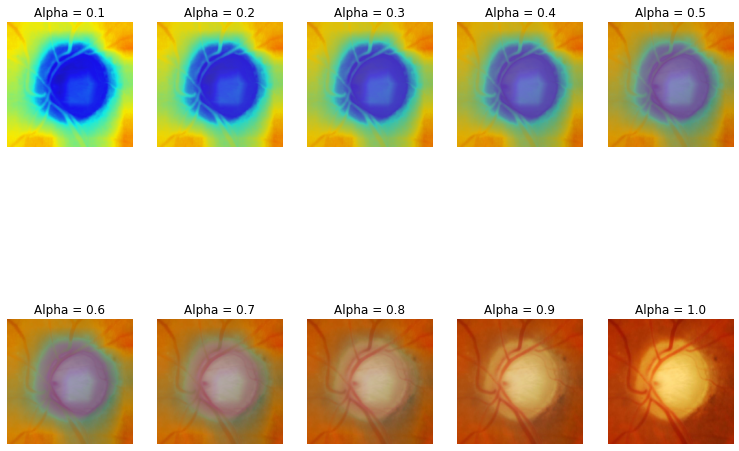

In [311]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

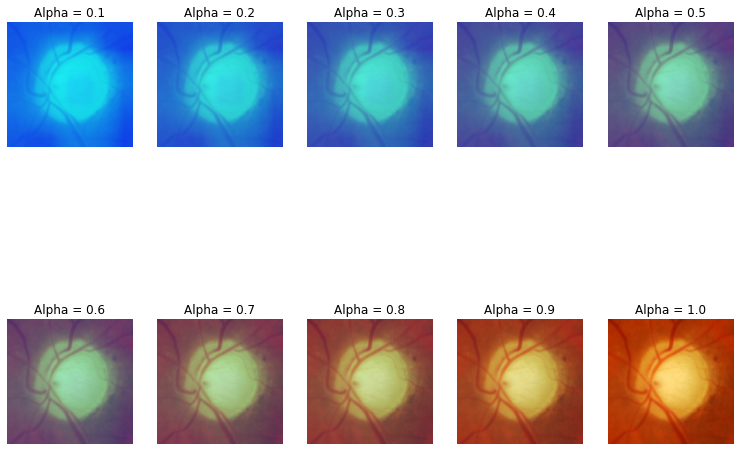

In [312]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_AUTUMN)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

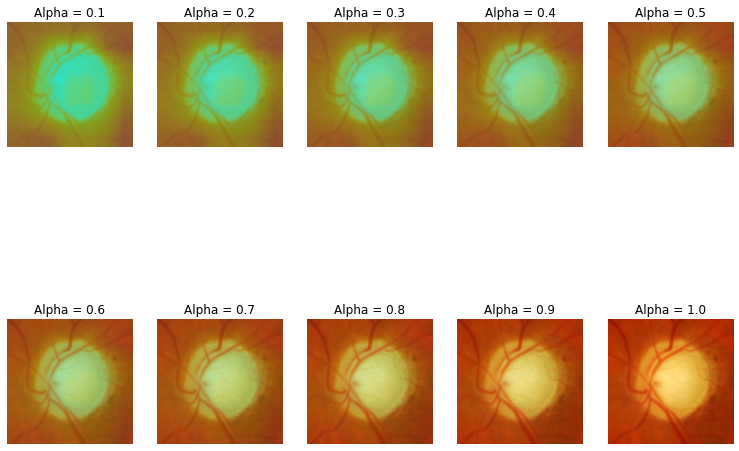

In [313]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_VIRIDIS)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

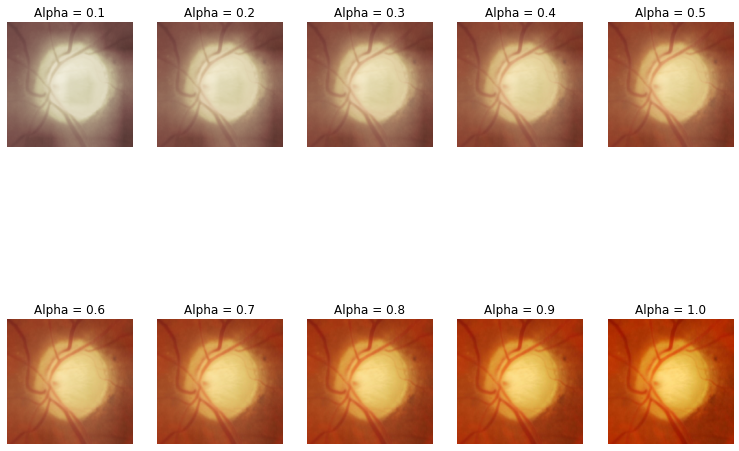

In [314]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_BONE)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

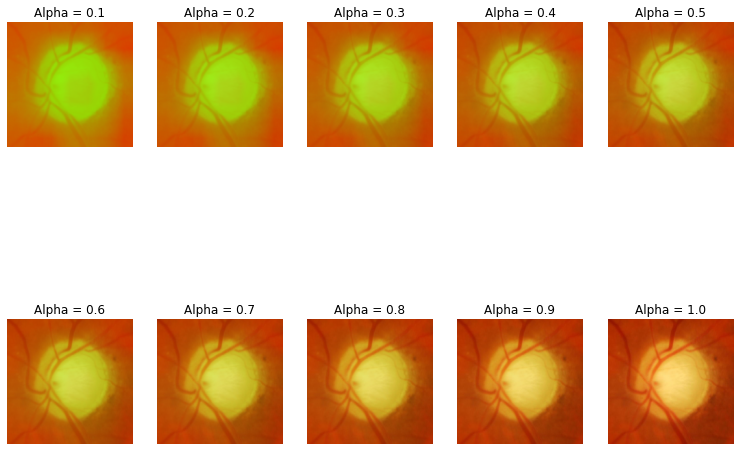

In [315]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_WINTER)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

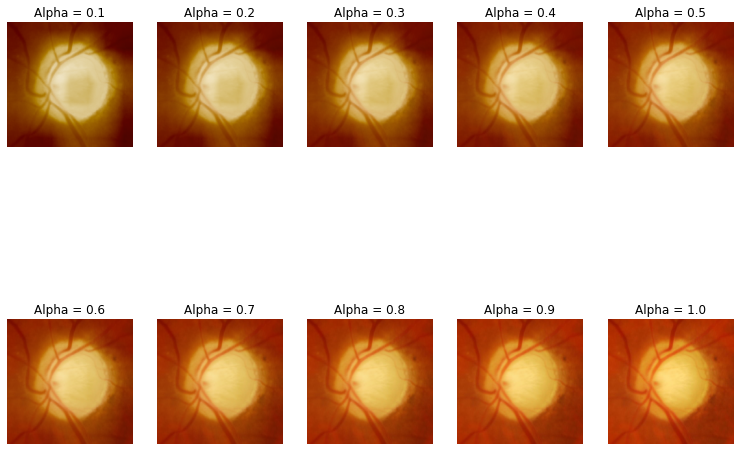

In [316]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_OCEAN)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

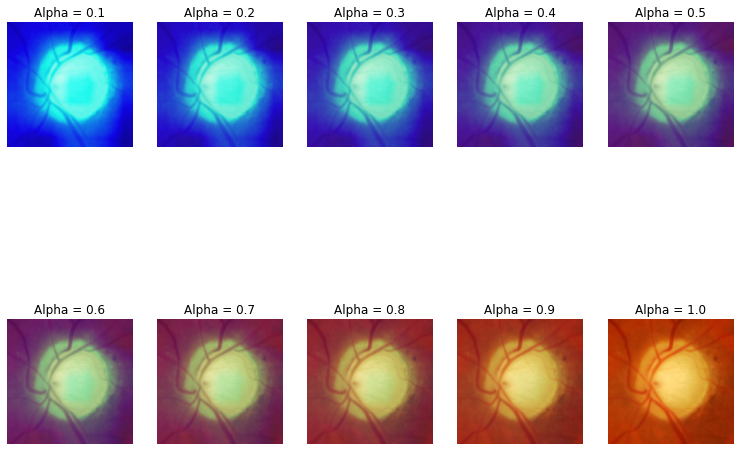

In [318]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_HOT)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

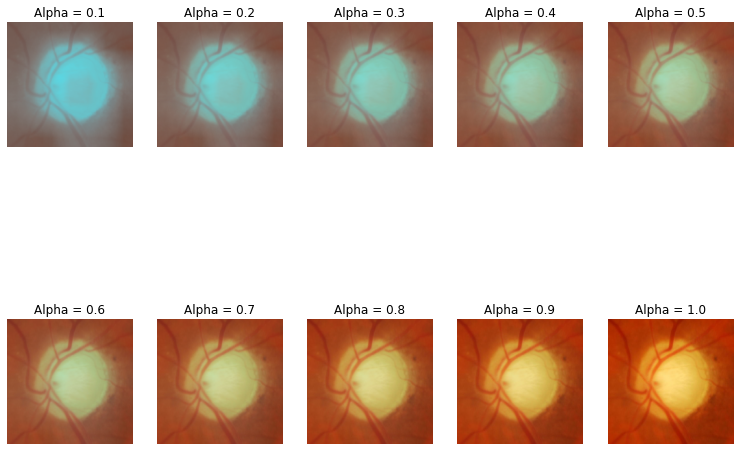

In [319]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_CIVIDIS)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

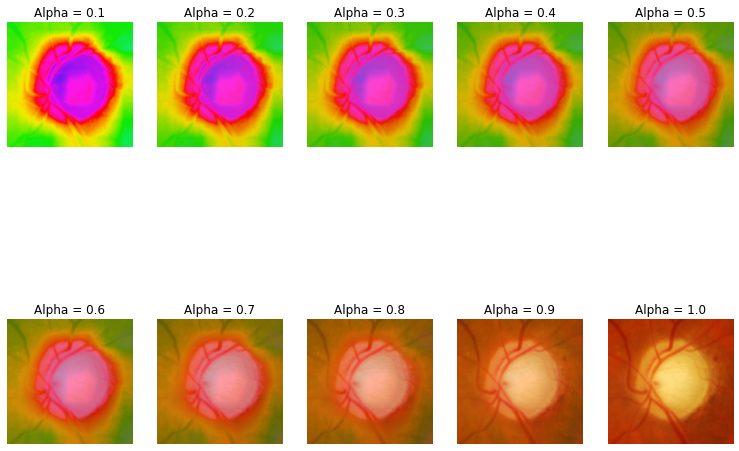

In [320]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_HSV)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

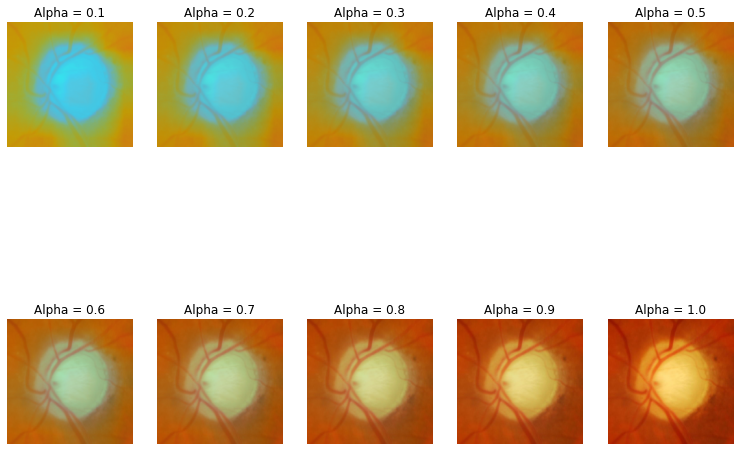

In [321]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_PARULA)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

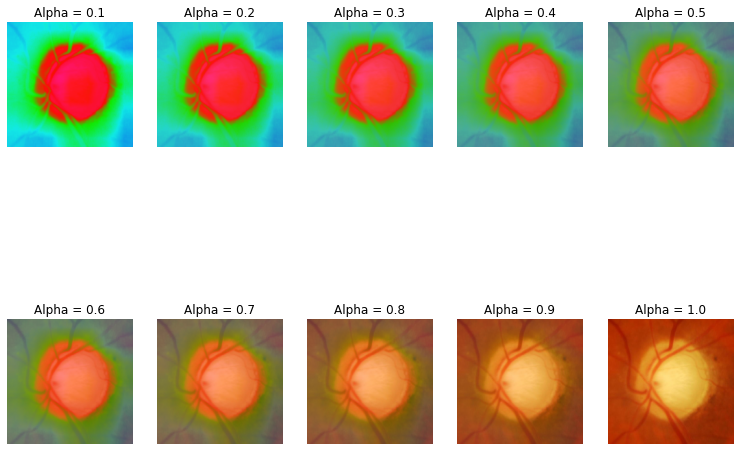

In [323]:
plt.figure(figsize=(13,10))
for idx, alpha in enumerate(alpha_params):
    plt.subplot(2,5,idx+1)
    _, output = overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_RAINBOW)
    plt.title(f'Alpha = {alpha:.1f}')
    plt.axis('off')
    plt.imshow(output)
plt.show()

For some reason colormaps are opaque (in JET blue shows the biggest response etc.)

### Different layers

In [327]:
!pip install pydot

In [330]:
!pip install graphviz

In [338]:
!apt-get install graphviz

^C
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  fontconfig fontconfig-config fonts-dejavu-core fonts-liberation libann0
  libcairo2 libcdt5 libcgraph6 libdatrie1 libfontconfig1 libfreetype6
  libfribidi0 libgd3 libgraphite2-3 libgts-0.7-5 libgts-bin libgvc6 libgvpr2
  libharfbuzz0b libice6 libjbig0 libjpeg-turbo8 libjpeg8 liblab-gamut1
  libltdl7 libpango-1.0-0 libpangocairo-1.0-0 libpangoft2-1.0-0 libpathplan4
  libpixman-1-0 libpng16-16 libsm6 libthai-data libthai0 libtiff5 libwebp6
  libxaw7 libxcb-render0 libxcb-shm0 libxmu6 libxpm4 libxrender1 libxt6 ucf
  x11-common
Suggested packages:
  gsfonts graphviz-doc libgd-tools
The following NEW packages will be installed:
  fontconfig fontconfig-config fonts-dejavu-core fonts-liberation graphviz
  libann0 libcairo2 libcdt5 libcgraph6 libdatrie1 libfontconfig1 libfreetype6
  libfribidi0 libgd3 libgraphite2-3 libgts-0.7-5 libgts-bin l

In [339]:
from tensorflow.keras import utils

In [340]:
utils.plot_model(resnet50.model, show_shapes=True)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


In [341]:
resnet50.model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_1 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_1[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1 (Conv2D)                 (None, 112, 112, 64  9472        ['zero_padding2d_1[0][0]']       
                                )                                                           

In [342]:
heatmap = explainer.explain(validation_data=(val_data/255.0, None),
                            model=resnet50.model,
                            class_index=0,
                            layer_name='conv1')

In [343]:
_, output = overlay_heatmap(heatmap, image, alpha=0.4)

In [344]:
output = np.hstack([image, output])

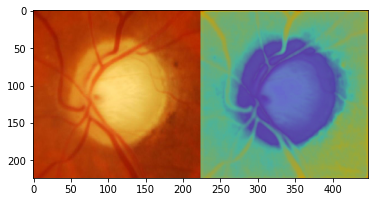

In [345]:
plt.figure()
plt.imshow(output)
plt.show()

In [346]:
heatmap = explainer.explain(validation_data=(val_data/255.0, None),
                            model=resnet50.model,
                            class_index=0,
                            layer_name='res2a_branch2b')

In [347]:
_, output = overlay_heatmap(heatmap, image, alpha=0.4)

In [348]:
output = np.hstack([image, output])

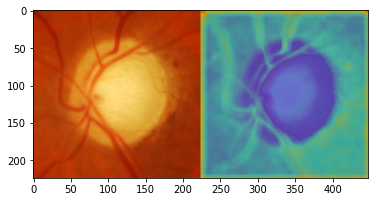

In [349]:
plt.figure()
plt.imshow(output)
plt.show()

In [350]:
heatmap = explainer.explain(validation_data=(val_data/255.0, None),
                            model=resnet50.model,
                            class_index=0,
                            layer_name='res4a_branch2c')

In [351]:
_, output = overlay_heatmap(heatmap, image, alpha=0.4)

In [352]:
output = np.hstack([image, output])

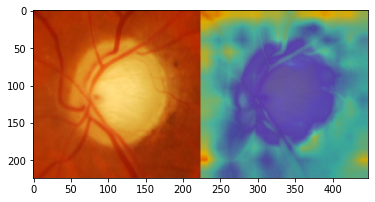

In [353]:
plt.figure()
plt.imshow(output)
plt.show()

In [354]:
heatmap = explainer.explain(validation_data=(val_data/255.0, None),
                            model=resnet50.model,
                            class_index=0,
                            layer_name='res5c_branch2b')

In [355]:
_, output = overlay_heatmap(heatmap, image, alpha=0.4)

In [356]:
output = np.hstack([image, output])

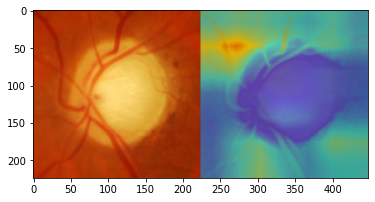

In [357]:
plt.figure()
plt.imshow(output)
plt.show()

In [359]:
heatmap = explainer.explain(validation_data=(val_data/255.0, None),
                            model=resnet50.model,
                            class_index=0,
                            layer_name='add_16')

In [360]:
_, output = overlay_heatmap(heatmap, image, alpha=0.4)

In [361]:
output = np.hstack([image, output])

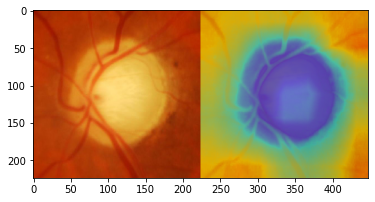

In [362]:
plt.figure()
plt.imshow(output)
plt.show()

In [8]:
df = resnet50.read_results('acrima')

In [9]:
df

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob
0,Im310_g_ACRIMA.jpg,Glaucoma,0.46714,0.53286,0,1,"(0.46714, 0.53286)"
1,Im311_g_ACRIMA.jpg,Glaucoma,0.95642,0.04358,0,0,"(0.95642, 0.04358)"
2,Im312_g_ACRIMA.jpg,Glaucoma,0.99976,0.00024,0,0,"(0.99976, 0.00024)"
3,Im313_g_ACRIMA.jpg,Glaucoma,0.99991,0.00009,0,0,"(0.99991, 9e-05)"
4,Im314_g_ACRIMA.jpg,Glaucoma,0.99996,0.00004,0,0,"(0.99996, 4e-05)"
...,...,...,...,...,...,...,...
700,Im305_ACRIMA.jpg,Healthy,0.00000,1.00000,1,1,"(0.0, 1.0)"
701,Im306_ACRIMA.jpg,Healthy,0.00025,0.99975,1,1,"(0.00025, 0.99975)"
702,Im307_ACRIMA.jpg,Healthy,0.00021,0.99979,1,1,"(0.00021, 0.99979)"
703,Im308_ACRIMA.jpg,Healthy,0.06100,0.93900,1,1,"(0.061, 0.939)"


In [20]:
df['class_0'] = np.array(df['y_prob'].to_list())[:,0]

In [21]:
df['class_1'] = np.array(df['y_prob'].to_list())[:,1]

In [25]:
temp = df[df['y_true'] == 0].sort_values(by='class_0')

In [13]:
class_1

array([0.99949, 0.99969, 0.87807, 0.97076, 0.99998, 0.99984, 0.98962,
       0.98685, 0.99999, 1.     , 0.99967, 0.9994 , 1.     , 0.99986,
       0.99999, 0.99784, 0.99981, 0.99142, 1.     , 0.99995, 0.98372,
       0.99327, 0.99873, 0.99978, 0.99987, 0.99979, 0.98958, 0.99999,
       0.99999, 0.99943, 0.99992, 0.99986, 0.99993, 0.99997, 0.99999,
       0.99161, 0.99999, 1.     , 0.99993, 0.99636, 0.99943, 0.99951,
       0.99998, 0.99998, 0.99998, 0.99999, 0.99999, 0.99984, 0.99859,
       0.99998, 0.99992, 0.99949, 0.97143, 0.9996 , 1.     , 1.     ,
       0.99997, 0.99999, 0.9996 , 0.99898, 0.9986 , 0.99998, 0.99992,
       0.99999, 1.     , 0.99999, 0.99997, 0.99964, 0.9999 , 1.     ,
       0.9994 , 0.99984, 0.99998, 0.99983, 0.99993, 0.99992, 1.     ,
       0.9999 , 0.99987, 0.9584 , 1.     , 0.99992, 0.97152, 0.99922,
       0.99997, 0.99992, 0.99998, 0.99613, 0.99996, 0.99946, 0.9998 ,
       1.     , 0.99999, 1.     , 0.9999 , 0.99963, 0.99999, 0.98829,
       0.99999, 0.99

In [30]:
temp[::-1][:5]

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob,class_0,class_1
197,Im507_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
6,Im316_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
280,Im590_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
64,Im374_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0
34,Im344_g_ACRIMA.jpg,Glaucoma,1.0,0.0,0,0,"(1.0, 0.0)",1.0,0.0


In [628]:
temp = df[df['y_true'] == 0]

In [630]:
temp

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob
0,Im310_g_ACRIMA.jpg,Glaucoma,0.98913,0.01087,0,0,"(0.98913, 0.01087)"
1,Im311_g_ACRIMA.jpg,Glaucoma,0.99980,0.00020,0,0,"(0.9998, 0.0002)"
2,Im312_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)"
3,Im313_g_ACRIMA.jpg,Glaucoma,1.00000,0.00000,0,0,"(1.0, 0.0)"
4,Im314_g_ACRIMA.jpg,Glaucoma,0.99988,0.00012,0,0,"(0.99988, 0.00012)"
...,...,...,...,...,...,...,...
391,Im701_g_ACRIMA.jpg,Glaucoma,0.97377,0.02623,0,0,"(0.97377, 0.02623)"
392,Im702_g_ACRIMA.JPG,Glaucoma,0.03282,0.96718,0,1,"(0.03282, 0.96718)"
393,Im703_g_ACRIMA.JPG,Glaucoma,0.99951,0.00049,0,0,"(0.99951, 0.00049)"
394,Im704_g_ACRIMA.jpg,Glaucoma,0.99839,0.00161,0,0,"(0.99839, 0.00161)"


In [629]:
temp[temp.index.isin(class_0)]

,image_name,Class,Glaucoma,Healthy,y_true,y_pred,y_prob
1,Im311_g_ACRIMA.jpg,Glaucoma,0.9998,0.0002,0,0,"(0.9998, 0.0002)"


In [ ]:
temp[temp.index.isin(class_0[class_0<0.5])]

In [631]:
def n_examples(df, class_prob, true_class, counterfactual, n=16)->(pd.DataFrame, np.ndarray, int, bool, int):
    temp = df[df['y_true'] == true_class]
    if counterfactual:
        examples = temp[temp.index.isin(class_prob[class_prob<0.5].argsort()[:n])]['image_name']
    else:
        examples = df['image_name'][df['y_true'] == true_class][class_prob > 1 - epsilon]
    return examples